# **EXECUTIVE SUMMARY**

* Exploration of avaialable data, selection of value added + natural resource intensive variables with the help of Claude

* Focus on World Bank Indicators. Tried to suppliment with GVC data but too many missing values. Larger role for IMF data in the future

* Analysed missing data in WBI, dropped variables if 50% > missing between 2015-2024. Standardised and Impted missing values using KNNImputer from sklearn (this approach is the most dubious part of my analysis)

* Focus on value-added, complexity, trade, gdp, and natural resource variables when clustering (Yes, I included natural resources like reource rents within my KMeans as I found it more insightful)

* Conducted K-means, analysed scree-plot, chose "optimal" number of clusters, rerun "optimal" KMeans, and visualise results
* Results have 7 clusters, of which I find clusters 1, 2, and 5 most interesting

## **DATA EXPLORATION**

Aim of this section is to understand data availability, structure, period-availability, and potential variables.

In [1]:
import pandas as pd
import numpy as np

In [2]:
# Show all rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_seq_items', None)

#### World Economic Outlook



In [3]:
weo = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\IMFData\WorldEconomicOutlook.csv")
weo.head()

C:\Users\ayaan\AppData\Local\Temp\ipykernel_26212\3078460004.py:1: DtypeWarning: Columns (2,38,39,40,41,42,43,47,48,49,56,57,58,59,60,61,119,121,126,127,131) have mixed types. Specify dtype option on import or set low_memory=False.
  weo = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\IMFData\WorldEconomicOutlook.csv")


,COUNTRY.ID,COUNTRY,COUNTRY.Description,INDICATOR.ID,INDICATOR,INDICATOR.Description,FREQUENCY.ID,FREQUENCY,FREQUENCY.Description,TIME_PERIOD,OBS_VALUE,SCALE.ID,SCALE,SCALE.Description,PRECISION.ID,PRECISION,PRECISION.Description,DECIMALS_DISPLAYED.ID,DECIMALS_DISPLAYED,DECIMALS_DISPLAYED.Description,FUNCTIONAL_CAT.ID,FUNCTIONAL_CAT,FUNCTIONAL_CAT.Description,INT_ACC_ITEM.ID,INT_ACC_ITEM,INT_ACC_ITEM.Description,NA_STO.ID,NA_STO,NA_STO.Description,GFS_STO.ID,GFS_STO,GFS_STO.Description,COICOP_1999.ID,COICOP_1999,COICOP_1999.Description,TRADE_FLOW.ID,TRADE_FLOW,TRADE_FLOW.Description,COMMODITY.ID,COMMODITY,COMMODITY.Description,SOC_CONCEPTS.ID,SOC_CONCEPTS,SOC_CONCEPTS.Description,SECTOR.ID,SECTOR,SECTOR.Description,ACCOUNTING_ENTRY.ID,ACCOUNTING_ENTRY,ACCOUNTING_ENTRY.Description,INDEX_TYPE.ID,INDEX_TYPE,INDEX_TYPE.Description,PRICES.ID,PRICES,PRICES.Description,STATISTICAL_MEASURES.ID,STATISTICAL_MEASURES,STATISTICAL_MEASURES.Description,EXRATE.ID,EXRATE,EXRATE.Description,TRANSFORMATION.ID,TRANSFORMATION,TRANSFORMATION.Description,UNIT.ID,UNIT,UNIT.Description,REPORTING_PERIOD_TYPE.ID,REPORTING_PERIOD_TYPE,REPORTING_PERIOD_TYPE.Description,DERIVATION_TYPE.ID,DERIVATION_TYPE,DERIVATION_TYPE.Description,OVERLAP.ID,OVERLAP,OVERLAP.Description,COUNTRY_UPDATE_DATE,DOI,FULL_DESCRIPTION,AUTHOR,PUBLISHER.ID,PUBLISHER,PUBLISHER.Description,DEPARTMENT.ID,DEPARTMENT,DEPARTMENT.Description,CONTACT_POINT,TOPIC.ID,TOPIC,TOPIC.Description,TOPIC_DATASET.ID,TOPIC_DATASET,TOPIC_DATASET.Description,KEYWORDS,KEYWORDS_DATASET,LANGUAGE.ID,LANGUAGE,LANGUAGE.Description,PUBLICATION_DATE,UPDATE_DATE,METHODOLOGY,METHODOLOGY_NOTES,ACCESS_SHARING_LEVEL.ID,ACCESS_SHARING_LEVEL,ACCESS_SHARING_LEVEL.Description,ACCESS_SHARING_NOTES,SECURITY_CLASSIFICATION.ID,SECURITY_CLASSIFICATION,SECURITY_CLASSIFICATION.Description,SOURCE.ID,SOURCE,SOURCE.Description,SHORT_SOURCE_CITATION,FULL_SOURCE_CITATION,LICENSE,SUGGESTED_CITATION,KEY_INDICATOR,SERIES_NAME,LATEST_ACTUAL_ANNUAL_DATA,HISTORICAL_DATA_SOURCE,BASE_YEAR,START_END_MONTHS_OF_REPORTING_YEAR,CHAIN_WEIGHTED,BASIS_OF_PROJECTIONS,VALUATION,PRICES_SECTOR_HARMONIZED_PRICES,LABOR_SECTOR_EMPLOYMENT_TYPE,FISCAL_SECTOR_GENERAL_GOVERNMENT_COMPOSITION,FISCAL_SECTOR_VALUATION_OF_DEBT,FISCAL_SECTOR_INSTRUMENTS_INCLUDED_IN_GROSS_AND_NET_DEBT,TRADE_SECTOR_OIL_COVERAGE,PRIMARY_DOMESTIC_CURRENCY
0,LIE,"Liechtenstein, Principality of",NaN,LE,"Employed persons, Persons for countries / Index for country groups",Persons above the age of 15 who were in paid employment or self-employment during a specified reference period. Persons for countries / Index for country groups.,A,Annual,To be used for data collected or disseminated every year.,2000.0,28000.0,6.0,Millions,"In scientific notation, expressed as ten raised to the power of six (10^6)",NaN,NaN,NaN,3.0,Three,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,E,Employed persons,Persons above the age of 15 who were in paid employment or self-employment during a specified reference period.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OL,Overlapping Indicator,"This indicator appears in other datasets published by the IMF. While every effort is made to ensure that estimates for the same indicator are consistent across datasets, differences can occur due to variations in sources and methods, splicing series to preserve time-series continuity, and timing differences in the collection, processing and publication of the indicator.",9/29/2025,NaN,"The World Economic Outlook (WEO) database contains selected macroeconomic data series from the statistical appendix of the World Economic Outlook report, which presents the IMF staff's analysis and projections of economic developments at the global level, in major country groups and in many individual countries. The WEO is released in April and September/October each year. Use this database to find data on national accounts, gross d

In [4]:
weo.INDICATOR.unique()

array(['Employed persons, Persons for countries / Index for country groups',
       'Gross domestic product (GDP), Current prices, Per capita, Domestic currency',
       'Population, Persons for countries / Index for country groups',
       'Gross domestic product (GDP), Constant prices, Domestic currency',
       'Current account balance (credit less debit), Percent of GDP',
       'Financial account balance (assets less liabilities), US dollar',
       'Net lending (+) / net borrowing (-), General government, Percent of GDP',
       'Gross domestic product (GDP), Price deflator, Index',
       'Expenditure, General government, Percent of GDP',
       'Net debt, General government, Domestic currency',
       'Revenue, General government, Percent of GDP',
       'Gross domestic product (GDP), Per capita, purchasing power parity (PPP) international dollar, ICP benchmarks 2017-2021',
       'Current account balance (credit less debit), US dollar',
       'Expenditure, General government,

In [5]:
industrial_development_indicators = [

    # GDP
    'Gross domestic product (GDP), Per capita, purchasing power parity (PPP) international dollar, ICP benchmarks 2017-2021',
    #'Gross domestic product (GDP), Constant prices, Percent change',

    # Employment and Labor Market
    #'Employed persons, Persons for countries / Index for country groups',
    #'Unemployment rate',
    
    # Manufacturing and Industrial Production
    #'Industrial materials, Commodity price index',
    
    # Trade Volumes and Values (key for industrialization)
    'Exports of goods and services, US dollar',
    'Imports of goods and services, US dollar',

    # Investment and Capital Formation
    'Gross capital formation, Percent of GDP',
    'Gross national savings, Percent of GDP',
    'Direct investment, Net (assets minus liabilities), US dollar',
    
    # Energy (proxy for industrial activity)
    #'Energy, Commodity price index',
    
    # Industrial Commodities (inputs for industrial production)
    #'Metal, Commodity price index',
    #'Aluminum, Unit prices, US dollars per metric tonne',
    #'Copper, Unit prices, US dollars per metric tonne',
    #'Iron ore, Unit prices, US dollars per metric tonne',
    #'Nickel, Unit prices, US dollars per metric tonne',
    #'Zinc, Unit prices, US dollars per metric tonne',
    #'Tin, Unit prices, US dollars per metric tonne',
    #'Lead, Unit prices, US dollars per metric tonne',
    #'Coal, Commodity price index'
]

### Global Value Chain Indicators

In [6]:
gvc = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\TradeData\gvc_output_WITS.csv")

gvc.head()

,country,sect,t,source,outp,outpd,outptt,gvco,gvcobp,gvcofp,gvcomix
0,ABW,1,1992,eora,4.550254,1.134122,1.875140,1.540992,0.329202,0.038029,1.173761
1,ABW,2,1992,eora,1.193926,-0.025127,-0.169288,1.388341,0.161795,-0.121724,1.348270
2,ABW,3,1992,eora,24.544487,8.139205,11.009832,5.395451,0.079091,1.053321,4.263038
3,ABW,4,1992,eora,13.739038,1.151441,7.031778,5.555819,2.056229,-0.073410,3.573000
4,ABW,5,1992,eora,2.816187,-0.412826,1.307602,1.921411,0.552225,-0.132032,1.501219


In [7]:
gvc1525 = gvc[gvc['t'].isin(range(2015,2025))]
gvc_agg = gvc1525.groupby(['country', 't'])[['outp', 'outpd', 'outptt', 'gvco', 'gvcobp', 'gvcofp', 'gvcomix']].sum()
gvc_agg = gvc_agg.reset_index()
gvc_agg

,country,t,outp,outpd,outptt,gvco,gvcobp,gvcofp,gvcomix
0,ABW,2015,5.413243e+03,3.003872e+03,1.575137e+03,8.342334e+02,1.992999e+02,8.758775e+01,5.473457e+02
1,AFG,2015,3.605938e+04,3.236217e+04,2.829627e+03,8.675820e+02,3.379783e+02,9.128332e+01,4.383204e+02
2,AGO,2015,2.469992e+05,1.779897e+05,4.798937e+04,2.102014e+04,1.666692e+03,6.676244e+03,1.267720e+04
3,ALB,2015,2.914553e+04,2.345655e+04,3.657767e+03,2.031214e+03,8.109358e+02,3.414591e+02,8.788188e+02
4,AND,2015,7.190691e+03,5.530532e+03,1.089349e+03,5.708106e+02,1.557930e+02,8.648586e+01,3.285318e+02
5,ANT,2015,8.687978e+03,3.669472e+03,3.654015e+03,1.364491e+03,2.738016e+02,3.451909e+02,7.454981e+02
6,ARE,2015,7.782654e+05,5.268107e+05,1.726959e+05,7.875882e+04,1.987932e+04,1.556710e+04,4.331241e+04
7,ARG,2015,1.831251e+06,1.450478e+06,2.861601e+05,9.461300e+04,2.412654e+04,2.345947e+04,4.702699e+04
8,ARG,2016,8.912362e+05,7.152841e+05,1.395717e+05,3.638033e+04,8.438998e+03,9.450857e+03,1.849048e+04
9,ARG,2017,1.024198e+06,8.332507e+05,1.506564e+05,4.029098e+04,9.877903e+03,1.008305e+04,2.033002e+04


### Trade 1 - Product/Sector-level trade statistics

In [8]:
t1 = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\TradeData\hs92_country_product_year_1.csv", nrows = 100)
t1.head()

,country_id,country_iso3_code,product_id,product_hs92_code,year,export_value,import_value,global_market_share,distance,cog,pci
0,4,AFG,1,0,1995,48199461,42655738,0.000114,0.940,0.001,-0.581
1,4,AFG,1,0,1996,35171120,65407786,0.000080,0.953,0.000,-0.598
2,4,AFG,1,0,1997,36052786,92504585,0.000078,0.935,0.000,-0.627
3,4,AFG,1,0,1998,22861201,68221438,0.000051,0.952,0.000,-0.630
4,4,AFG,1,0,1999,22305299,56959175,0.000050,0.939,0.001,-0.664


### Trade 2 - Export/ECI/COI/Diversity

In [9]:
t2 = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\TradeData\hs92_country_year.csv")
t2.head()

,country_id,country_iso3_code,year,export_value,import_value,eci,coi,diversity,growth_proj
0,4,AFG,1995,79592361,299171458,-0.473,-0.653,67.0,NaN
1,4,AFG,1996,83966260,449405900,-0.477,-0.627,53.0,NaN
2,4,AFG,1997,103337092,392067579,0.063,-0.320,77.0,NaN
3,4,AFG,1998,118444378,310559568,-0.278,-0.685,53.0,NaN
4,4,AFG,1999,81579366,323718948,-0.249,-0.587,68.0,NaN


## World Bank Indicators

In [10]:
wbi = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\WorldBankIndicators\WBI.csv", nrows = 1000)
wbi.head()

C:\Users\ayaan\AppData\Local\Temp\ipykernel_26212\3381426031.py:1: DtypeWarning: Columns (1528,1534,1563,1564,1565,1566,1567) have mixed types. Specify dtype option on import or set low_memory=False.
  wbi = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\WorldBankIndicators\WBI.csv", nrows = 1000)


year  iso iso2code  countryname  idc  isregion  region  regionname  \
0  1946  AFG       AF          NaN    3       0.0     NaN         NaN   
1  1946  AGO       AO          NaN    5       0.0     NaN         NaN   
2  1946  ALB       AL          NaN    7       0.0     NaN         NaN   
3  1946  AND       AD          NaN    8       0.0     NaN         NaN   
4  1946  ARE       AE          NaN   12       0.0     NaN         NaN   

  regioncode  adminregion  adminregionname  ag_con_fert_pt_zs  ag_con_fert_zs  \
0        SAS          NaN              NaN                NaN             NaN   
1        SSF          NaN              NaN                NaN             NaN   
2        ECS          NaN              NaN                NaN             NaN   
3        ECS          NaN              NaN                NaN             NaN   
4        MEA          NaN              NaN                NaN             NaN   

   ag_lnd_agri_k2  ag_lnd_agri_zs  ag_lnd_arbl_ha  ag_lnd_arbl_ha_pc  \
0             NaN             NaN             NaN                NaN   
1             NaN             NaN             NaN                NaN   
2             NaN             NaN             NaN                NaN   
3             NaN             NaN             NaN                NaN   
4             NaN             NaN             NaN                NaN   

   ag_lnd_arbl_zs  ag_lnd_crel_ha  ag_lnd_crop_zs  ag_lnd_el5m_ru_k2  \
0             NaN             NaN             NaN                NaN   
1             NaN             NaN             NaN                NaN   
2             NaN             NaN             NaN                NaN   
3             NaN             NaN             NaN                NaN   
4             NaN             NaN             NaN                NaN   

   ag_lnd_el5m_ru_zs  ag_lnd_el5m_ur_k2  ag_lnd_el5m_ur_zs  ag_lnd_el5m_zs  \
0                NaN                NaN                NaN             NaN   
1                NaN                NaN                NaN             NaN   
2                NaN                NaN                NaN             NaN   
3                NaN                NaN                NaN             NaN   
4                NaN                NaN                NaN             NaN   

   ag_lnd_frst_k2  ag_lnd_frst_zs  ag_lnd_irig_ag_zs  ag_lnd_prcp_mm  \
0             NaN             NaN                NaN             NaN   
1             NaN             NaN                NaN             NaN   
2             NaN             NaN                NaN             NaN   
3             NaN             NaN                NaN             NaN   
4             NaN             NaN                NaN             NaN   

   ag_lnd_totl_k2  ag_lnd_totl_ru_k2  ag_lnd_totl_ur_k2  ag_prd_crel_mt  \
0             NaN                NaN                NaN             NaN   
1             NaN                NaN                NaN             NaN   
2             NaN                NaN                NaN             NaN   
3             NaN                NaN                NaN             NaN   
4             NaN                NaN                NaN             NaN   

   ag_prd_crop_xd  ag_prd_food_xd  ag_prd_lvsk_xd  ag_srf_totl_k2  \
0             NaN             NaN             NaN             NaN   
1             NaN             NaN             NaN             NaN   
2             NaN             NaN             NaN             NaN   
3             NaN             NaN             NaN             NaN   
4             NaN             NaN             NaN             NaN   

   ag_yld_crel_kg  bg_gsr_nfsv_gd_zs  bm_gsr_cmcp_zs  bm_gsr_fcty_cd  \
0             NaN                NaN             NaN             NaN   
1             NaN                NaN             NaN             NaN   
2             NaN                NaN             NaN             NaN   
3             NaN                NaN             NaN             NaN   
4             NaN                NaN             NaN             NaN   

   bm_gsr_

In [11]:
wbi.columns

Index(['year', 'iso', 'iso2code', 'countryname', 'idc', 'isregion', 'region',
       'regionname', 'regioncode', 'adminregion', 'adminregionname',
       'ag_con_fert_pt_zs', 'ag_con_fert_zs', 'ag_lnd_agri_k2',
       'ag_lnd_agri_zs', 'ag_lnd_arbl_ha', 'ag_lnd_arbl_ha_pc',
       'ag_lnd_arbl_zs', 'ag_lnd_crel_ha', 'ag_lnd_crop_zs',
       'ag_lnd_el5m_ru_k2', 'ag_lnd_el5m_ru_zs', 'ag_lnd_el5m_ur_k2',
       'ag_lnd_el5m_ur_zs', 'ag_lnd_el5m_zs', 'ag_lnd_frst_k2',
       'ag_lnd_frst_zs', 'ag_lnd_irig_ag_zs', 'ag_lnd_prcp_mm',
       'ag_lnd_totl_k2', 'ag_lnd_totl_ru_k2', 'ag_lnd_totl_ur_k2',
       'ag_prd_crel_mt', 'ag_prd_crop_xd', 'ag_prd_food_xd', 'ag_prd_lvsk_xd',
       'ag_srf_totl_k2', 'ag_yld_crel_kg', 'bg_gsr_nfsv_gd_zs',
       'bm_gsr_cmcp_zs', 'bm_gsr_fcty_cd', 'bm_gsr_gnfs_cd', 'bm_gsr_insf_zs',
       'bm_gsr_mrch_cd', 'bm_gsr_nfsv_cd', 'bm_gsr_royl_cd', 'bm_gsr_totl_cd',
       'bm_gsr_tran_zs', 'bm_gsr_trvl_zs', 'bm_klt_dinv_cd_wd',
       'bm_klt_dinv_wd_gd_zs', 'bm

WBI relevant columns were exytracted by prompting Claude for relevant variables for research question and the column list above. Plus adding the 6 World Governance Indicators

In [ ]:
columns_req = [
    #ADMIN
    'year', 'iso', 'countryname',
    
    # GDP
    'ny_gdp_pcap_cd', # GDP per capita (current US$)
    'ny_gnp_atls_cd', # GNI, Atlas method (current US$)

    # Resource Intensity
    'ny_gdp_totl_rt_zs', # Total natural resources rents (% of GDP)
    'ny_gdp_coal_rt_zs', # Coal rents (% of GDP)
    'ny_gdp_frst_rt_zs', # Forest rents (% of GDP)
    'ny_gdp_minr_rt_zs', # Mineral rents (% of GDP)
    'ny_gdp_ngas_rt_zs', # Natural gas rents (% of GDP)
    'ny_gdp_petr_rt_zs', # Oil rents (% of GDP)

    # Resource Depletion
    'ny_adj_dres_gn_zs', # Adjusted savings: natural resources depletion (% of GNI)
    'ny_adj_dmin_gn_zs', # Adjusted savings: mineral depletion (% of GNI)
    'ny_adj_dngy_gn_zs', # Adjusted savings: energy depletion (% of GNI)
    'ny_adj_dfor_gn_zs', # Adjusted savings: forest depletion (% of GNI)

    # Manufacturing & Industrial Output
    'nv_ind_manf_zs',        # Manufacturing, value added (% of GDP)
    'nv_ind_totl_zs',        # Industry (including construction), value added (% of GDP)
    'tx_val_manf_zs_un',     # Manufactures exports (% of merchandise exports)
    'tx_val_tech_mf_zs',     # High-technology exports (% of manufactured exports)
    #'tx_mnf_tech_zs_un',     # Medium and high-tech exports (% manufactured exports)
    'nv_agr_totl_zs',         # Agriculture, forestry, and fishing, value added (% of GDP)
    'nv_srv_totl_zs',         # Services, value added (% of GDP)

    'nv_mnf_chem_zs_un', # Chemicals (% of manufacturing value added)
    'nv_mnf_fbto_zs_un', # Food, beverages and tobacco (% of manufacturing value added)
    #'nv_mnf_mtrn_zs_un', # Machinery and transport equipment (% of manufacturing value added)
    #'nv_mnf_othr_zs_un', # Other manufacturing (% of manufacturing value added)
    #'nv_mnf_tech_zs_un', # Medium and high-tech manufacturing value added (% of manufacturing value added)
    'nv_mnf_txtl_zs_un', # Textiles and clothing (% of manufacturing value added)

    #'nv_fsm_totl_cd', # Manufacturing and services, value added (current USD)
    
    'tx_val_fuel_zs_un', # Fuel exports (% of merchandise exports)
    'tx_val_mmtl_zs_un', # Ores and metals exports (% of merchandise exports)
    'tx_val_food_zs_un', # Food exports (% of merchandise exports)
    'tx_val_agri_zs_un', # Agricultural raw materials exports (% of merchandise exports)

    # Economic Complexity & Diversification
    'eci',                   # Economic Complexity Index
    'diversity',             # Export diversity measure
    'oppval',                # Opportunity value (potential for developing new products)
    #'hd_hci_ovrl',           # Human Capital Index
    
    # Employment Transformation
    'sl_ind_empl_zs',       # Employment in industry (% of total employment)
    'sl_srv_empl_zs',       # Employment in services (% of total employment)
    'sl_agr_empl_zs',       # Employment in agriculture (% of total) - should decrease
    
    # Investment & Capital Formation
    'bx_klt_dinv_wd_gd_zs', # Foreign direct investment, net inflows (% of GDP)
    
    # Innovation & Technology
    #'gb_xpd_rsdv_gd_zs',    # Research and development expenditure (% of GDP)
    
    # Trade Sophistication
    'ne_trd_gnfs_zs',       # Trade (% of GDP)
    #'tm_tax_mrch_wm_ar_zs', # Tariff Rate
    #'ny_ttf_gnfs_kn',       # Terms of trade
    
    # World Governance Indicators
    'rq_est',              # Regulatory Quality: Estimate (-2.5 to 2.5)

    'cc_est',              # Control of Corruption: Estimate (-2.5 to 2.5)
    
    'pv_est',              # Political Stability and Absence of Violence/Terrorism: Estimate
    
    'rl_est',              # Rule of Law: Estimate (-2.5 to 2.5)
    
    'va_est',              # Voice and Accountability: Estimate (-2.5 to 2.5)

    'ge_est'               # Government Effectiveness: Estimate 
]

In [61]:
wbi = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\WorldBankIndicators\WBI.csv", usecols=columns_req)
wbi.shape

C:\Users\ayaan\AppData\Local\Temp\ipykernel_26212\3756021541.py:1: DtypeWarning:

Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.



(21760, 42)

In [62]:
wbi1525 = wbi[wbi['year'].isin(range(2015,2025))]

In [63]:
# Other Datasets
vdem = r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\VDem\V-Dem-CY-Core-v15_csv\V-Dem-CY-Core-v15.csv"
fx = r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\IMFData\ExchangeRates_USDperLCU.csv"
rca = r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\TradeData\RCA"

## **CREATING MASTER DATA** 

### METHODOLOGY

Approach to follow:

1)	Select EMEs with high dependency on natural resources

2)	Which EMEs were successful in upgrading their value chains? Cluster EME based on their industrial development trajectories to have an initial idea of natural groupings.

    i.	Features: ECI growth, manufacturing share of GDP, natural resource to GDP ratios, etc. I wouldn’t use too many variables, let’s keep it simple
    
    ii.	Create a label based on their cluster (i.e., “successful country “, “unsuccessful country”, “other”). 
        


**My General Approach**:
* Use WBI as the primary source
* For each varaible, conduct cost-benefit analysis and evaluate whether it should feature as a clusteirng variable. 
* If WBI data is missing, evaluate missingness, try to suppliment with other datasets
* Conduct KNN Imputation for any remaining missing values
* Variable selection for clustering
* Standardization of variables
* Conduct Clustering
* Find feature importance ?!

In [64]:
wbi1525

,year,iso,countryname,bx_klt_dinv_wd_gd_zs,cc_est,ge_est,ne_trd_gnfs_zs,nv_agr_totl_zs,nv_ind_manf_zs,nv_ind_totl_zs,nv_mnf_chem_zs_un,nv_mnf_fbto_zs_un,nv_mnf_txtl_zs_un,nv_srv_totl_zs,ny_adj_dfor_gn_zs,ny_adj_dmin_gn_zs,ny_adj_dngy_gn_zs,ny_adj_dres_gn_zs,ny_gdp_coal_rt_zs,ny_gdp_frst_rt_zs,ny_gdp_minr_rt_zs,ny_gdp_ngas_rt_zs,ny_gdp_pcap_cd,ny_gdp_petr_rt_zs,ny_gdp_totl_rt_zs,ny_gnp_atls_cd,pv_est,rl_est,rq_est,sl_agr_empl_zs,sl_ind_empl_zs,sl_srv_empl_zs,tx_val_agri_zs_un,tx_val_food_zs_un,tx_val_fuel_zs_un,tx_val_manf_zs_un,tx_val_mmtl_zs_un,tx_val_tech_mf_zs,va_est,eci,oppval,diversity
19114,2015,ABW,Aruba,-0.907264,1.248301,0.847599,145.833660,0.012520,3.585279,12.468823,NaN,NaN,NaN,79.139053,0.002493,0.000000e+00,0.000000e+00,0.002493,0.000000,0.002388,0.000000,0.000000,27458.22500,0.000000,0.002388,2.639315e+09,1.210239,1.227138,1.358143,NaN,NaN,NaN,0.092621,59.034233,1.972993e-01,31.891434,4.379361,4.968986,1.273995,0.648689,0.139927,69.0
19115,2015,AFE,Africa Eastern and Southern,3.169598,NaN,NaN,55.445644,12.856239,10.322483,25.216101,NaN,NaN,NaN,54.030251,2.914212,3.626647e-01,1.537549e+00,4.814426,0.619201,3.705007,0.546853,0.059172,1479.56410,1.565946,6.496179,9.229447e+11,NaN,NaN,NaN,58.242893,10.203942,31.553167,2.015900,14.730751,2.491934e+01,33.426804,20.152105,6.428486,NaN,NaN,NaN,NaN
19116,2015,AFG,Afghanistan,0.884000,-1.354713,-1.397395,NaN,20.634323,11.420006,22.124043,NaN,NaN,NaN,53.235294,0.232762,1.512238e-03,5.598678e-02,0.290261,0.163205,0.288935,0.001989,0.002153,565.56970,0.013636,0.469917,2.011410e+10,-2.562625,-1.516201,-1.018826,44.593517,20.713533,34.692963,14.799067,48.456108,3.450456e+00,15.862603,1.065253,NaN,-1.117628,-1.204028,-1.064153,53.0
19117,2015,AFW,Africa Western and Central,1.956009,NaN,NaN,NaN,20.170813,10.242908,22.908520,NaN,NaN,NaN,53.241058,1.214396,2.957700e-01,1.644742e+00,3.154908,0.028347,2.510258,0.399821,0.498667,1845.76780,2.666028,6.103121,8.247284e+11,NaN,NaN,NaN,45.740952,12.418917,41.840134,3.308715,15.455170,5.379207e+01,18.131252,2.764997,5.080136,NaN,NaN,NaN,NaN
19118,2015,AGO,Angola,11.081339,-1.427726,-0.929087,62.888515,9.122535,5.685145,41.933094,NaN,NaN,NaN,48.659889,0.554707,0.000000e+00,1.039628e+01,10.950982,0.000000,0.526504,0.000000,0.060441,3213.90260,12.718730,13.305675,1.104143e+11,-0.505386,-1.030659,-0.863671,56.849903,7.798359,35.351730,0.033736,0.314687,9.401591e+01,2.385452,3.243921,12.604486,-1.177165,-1.592811,-1.254731,8.0
19119,2015,AIA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.001396,0.080729,61.0
19120,2015,ALB,Albania,8.690534,-0.545141,0.027575,71.801010,19.780214,5.671519,21.763681,3.309604,16.950294,32.388367,46.284443,0.189124,3.387530e-02,1.009346e+00,1.232345,0.005983,0.191365,0.065795,0.019113,3952.80350,1.452606,1.734862,1.263576e+10,0.341639,-0.319687,0.174237,41.283524,18.669819,40.046658,2.305902,5.643205,8.806639e+00,52.664883,7.545843,1.634190,0.157135,-0.617195,-0.154264,112.0
19121,2015,AND,Andorra,NaN,1.151729,1.740735,NaN,0.513420,3.706090,9.981269,NaN,NaN,NaN,78.667412,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,38654.93400,NaN,0.000000,NaN,1.365985,1.513192,0.898378,NaN,NaN,NaN,1.586937,1.099814,4.449066e-02,88.809425,4.508606,22.645569,1.194455,0.760682,0.459982,98.0
19122,2015,ANS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.494107,-0.208191,54.0
19123,2015,ARB,Arab World,1.172429,NaN,NaN,83.119614,5.672523,10.691272,40.563290,NaN,NaN,NaN,53.315479,0.090673,3.771035e-02,6.060123e+00,6.226127,0.002484,0.150089,0.186994,1.272420,6203.70260,15.454213,17.066198,2.810691e+12,NaN,NaN,NaN,19.098936,24.919855,55.981213,0.163650,3.424833,6.064662e+01,15.942287,3.557887,2.825852,NaN,NaN,NaN,NaN


In [65]:
iso2025 = pd.read_csv(r"C:\Users\ayaan\OneDrive - London School of Economics\Gallegos-Viza,CL (pgt)'s files - Capstone project\data\Rawdata\ISO2025.csv")
valid_iso = iso2025['cca3']
wbi1525 = wbi1525[wbi1525['iso'].isin(valid_iso)]
wbi1525.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2024 entries, 19114 to 21759
Data columns (total 42 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   year                  2024 non-null   int64  
 1   iso                   2024 non-null   object 
 2   countryname           1926 non-null   object 
 3   bx_klt_dinv_wd_gd_zs  1657 non-null   float64
 4   cc_est                1827 non-null   float64
 5   ge_est                1827 non-null   float64
 6   ne_trd_gnfs_zs        1601 non-null   float64
 7   nv_agr_totl_zs        1715 non-null   float64
 8   nv_ind_manf_zs        1635 non-null   float64
 9   nv_ind_totl_zs        1741 non-null   float64
 10  nv_mnf_chem_zs_un     662 non-null    float64
 11  nv_mnf_fbto_zs_un     688 non-null    float64
 12  nv_mnf_txtl_zs_un     688 non-null    float64
 13  nv_srv_totl_zs        1739 non-null   float64
 14  ny_adj_dfor_gn_zs     1232 non-null   float64
 15  ny_adj_dmin_gn_zs    

In [66]:
wbi_gvc = pd.merge(wbi1525, gvc_agg, left_on= ['iso', 'year'], right_on=['country', 't'], how= 'left')
wbi_gvc

,year,iso,countryname,bx_klt_dinv_wd_gd_zs,cc_est,ge_est,ne_trd_gnfs_zs,nv_agr_totl_zs,nv_ind_manf_zs,nv_ind_totl_zs,nv_mnf_chem_zs_un,nv_mnf_fbto_zs_un,nv_mnf_txtl_zs_un,nv_srv_totl_zs,ny_adj_dfor_gn_zs,ny_adj_dmin_gn_zs,ny_adj_dngy_gn_zs,ny_adj_dres_gn_zs,ny_gdp_coal_rt_zs,ny_gdp_frst_rt_zs,ny_gdp_minr_rt_zs,ny_gdp_ngas_rt_zs,ny_gdp_pcap_cd,ny_gdp_petr_rt_zs,ny_gdp_totl_rt_zs,ny_gnp_atls_cd,pv_est,rl_est,rq_est,sl_agr_empl_zs,sl_ind_empl_zs,sl_srv_empl_zs,tx_val_agri_zs_un,tx_val_food_zs_un,tx_val_fuel_zs_un,tx_val_manf_zs_un,tx_val_mmtl_zs_un,tx_val_tech_mf_zs,va_est,eci,oppval,diversity,country,t,outp,outpd,outptt,gvco,gvcobp,gvcofp,gvcomix
0,2015,ABW,Aruba,-0.907264,1.248301,0.847599,145.833660,0.012520,3.585279,12.468823,NaN,NaN,NaN,79.139053,0.002493,0.000000e+00,0.000000e+00,0.002493,0.000000,0.002388,0.000000,0.000000,27458.22500,0.000000,0.002388,2.639315e+09,1.210239,1.227138,1.358143,NaN,NaN,NaN,0.092621,59.034233,1.972993e-01,31.891434,4.379361,4.968986,1.273995,0.648689,0.139927,69.0,ABW,2015.0,5.413243e+03,3.003872e+03,1.575137e+03,8.342334e+02,1.992999e+02,8.758775e+01,5.473457e+02
1,2015,AFG,Afghanistan,0.884000,-1.354713,-1.397395,NaN,20.634323,11.420006,22.124043,NaN,NaN,NaN,53.235294,0.232762,1.512238e-03,5.598678e-02,0.290261,0.163205,0.288935,0.001989,0.002153,565.56970,0.013636,0.469917,2.011410e+10,-2.562625,-1.516201,-1.018826,44.593517,20.713533,34.692963,14.799067,48.456108,3.450456e+00,15.862603,1.065253,NaN,-1.117628,-1.204028,-1.064153,53.0,AFG,2015.0,3.605938e+04,3.236217e+04,2.829627e+03,8.675820e+02,3.379783e+02,9.128332e+01,4.383204e+02
2,2015,AGO,Angola,11.081339,-1.427726,-0.929087,62.888515,9.122535,5.685145,41.933094,NaN,NaN,NaN,48.659889,0.554707,0.000000e+00,1.039628e+01,10.950982,0.000000,0.526504,0.000000,0.060441,3213.90260,12.718730,13.305675,1.104143e+11,-0.505386,-1.030659,-0.863671,56.849903,7.798359,35.351730,0.033736,0.314687,9.401591e+01,2.385452,3.243921,12.604486,-1.177165,-1.592811,-1.254731,8.0,AGO,2015.0,2.469992e+05,1.779897e+05,4.798937e+04,2.102014e+04,1.666692e+03,6.676244e+03,1.267720e+04
3,2015,AIA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.001396,0.080729,61.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2015,ALB,Albania,8.690534,-0.545141,0.027575,71.801010,19.780214,5.671519,21.763681,3.309604,16.950294,32.388367,46.284443,0.189124,3.387530e-02,1.009346e+00,1.232345,0.005983,0.191365,0.065795,0.019113,3952.80350,1.452606,1.734862,1.263576e+10,0.341639,-0.319687,0.174237,41.283524,18.669819,40.046658,2.305902,5.643205,8.806639e+00,52.664883,7.545843,1.634190,0.157135,-0.617195,-0.154264,112.0,ALB,2015.0,2.914553e+04,2.345655e+04,3.657767e+03,2.031214e+03,8.109358e+02,3.414591e+02,8.788188e+02
5,2015,AND,Andorra,NaN,1.151729,1.740735,NaN,0.513420,3.706090,9.981269,NaN,NaN,NaN,78.667412,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,38654.93400,NaN,0.000000,NaN,1.365985,1.513192,0.898378,NaN,NaN,NaN,1.586937,1.099814,4.449066e-02,88.809425,4.508606,22.645569,1.194455,0.760682,0.459982,98.0,AND,2015.0,7.190691e+03,5.530532e+03,1.089349e+03,5.708106e+02,1.557930e+02,8.648586e+01,3.285318e+02
6,2015,ARE,United Arab Emirates,4.507887,1.034574,1.500492,169.476240,0.723672,9.175894,43.354244,1.447843,8.718852,3.852896,55.922085,0.000210,0.000000e+00,4.139806e+00,4.140016,0.000000,0.000211,0.000000,0.944063,43534.99600,13.102534,14.046809,4.125726e+11,0.748049,0.614162,1.096597,2.069539,31.454662,66.475800,0.075465,1.911553,3.765155e+01,10.290129,4.523681,5.301998,-1.112433,-0.053008,-0.428635,72.0,ARE,2015.0,7.782654e+05,5.268107e+05,1.726959e+05,7.875882e+04,1.987932e+04,1.556710e+04,4.331241e+04
7,2015,ARG,Argentina,1.977135,-0.581265,-0.049476,22.486227,5.156686,14.181585,23.153055,11.235382,29.730305,8.600843,55.814899,0.000000,5.154301e-02,7.899792e-01,0.841522,0.000099,0.099378,0.076578,0.246808,13679.62700,0.693912,1.116775,5.432799e+11,0.008764,-0.748636,-0.898022,7.84271

MISSING VALUES ANALYSIS BY ISO

1. Summary of Missing Values by ISO:
ISO  Total_Missing  Missing_Percentage
REU             49          100.000000
MAF            430           97.505669
AIA            368           93.877551
ESH            368           93.877551
FLK            368           93.877551
VAT            368           93.877551
TKL            368           93.877551
MSR            368           93.877551
NIU            368           93.877551
BLM            368           93.877551
... showing top 10 of 227 ISOs

MISSING VALUES ANALYSIS BY YEAR

2. Summary of Missing Values by Year:
 Year  Total_Missing  Missing_Percentage  Num_Countries
 2015           1987           17.863886            227
 2016           2942           26.566733            226
 2017           2922           26.386130            226
 2018           2942           26.566733            226
 2019           2994           27.036301            226
 2020           3083           27.839986            226
 2021  

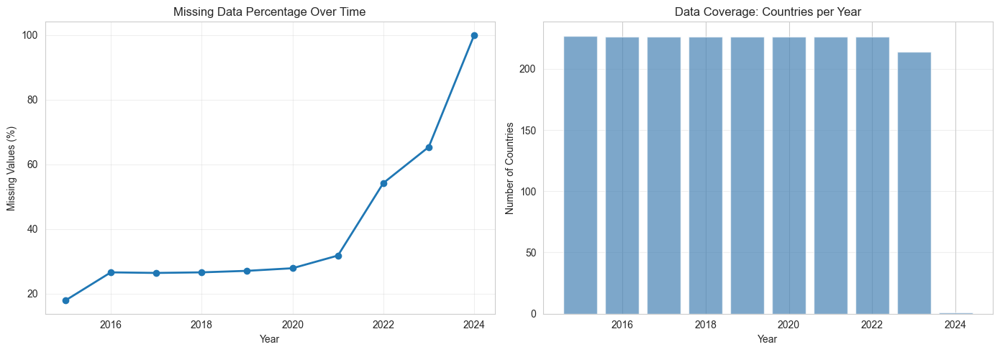


3. Detailed Missing Values by ISO and Variable:

Variables with highest missing rates (averaged across ISOs):
                   Missing_Count  Missing_Pct
Variable                                     
country                     1423        70.55
gvcomix                     1423        70.55
gvcobp                      1423        70.55
gvco                        1423        70.55
gvcofp                      1423        70.55
outpd                       1423        70.55
outptt                      1423        70.55
t                           1423        70.55
outp                        1423        70.55
nv_mnf_chem_zs_un           1362        67.60

4. Missing Values by Year and Variable:

Variables with changing missing rates over time:

countryname:
  Min missing: 0.0% (Year 2023)
  Max missing: 100.0% (Year 2024)
  Std deviation: 30.2%

bx_klt_dinv_wd_gd_zs:
  Min missing: 16.7% (Year 2015)
  Max missing: 100.0% (Year 2024)
  Std deviation: 25.9%

cc_est:
  Min missing: 5.1% (

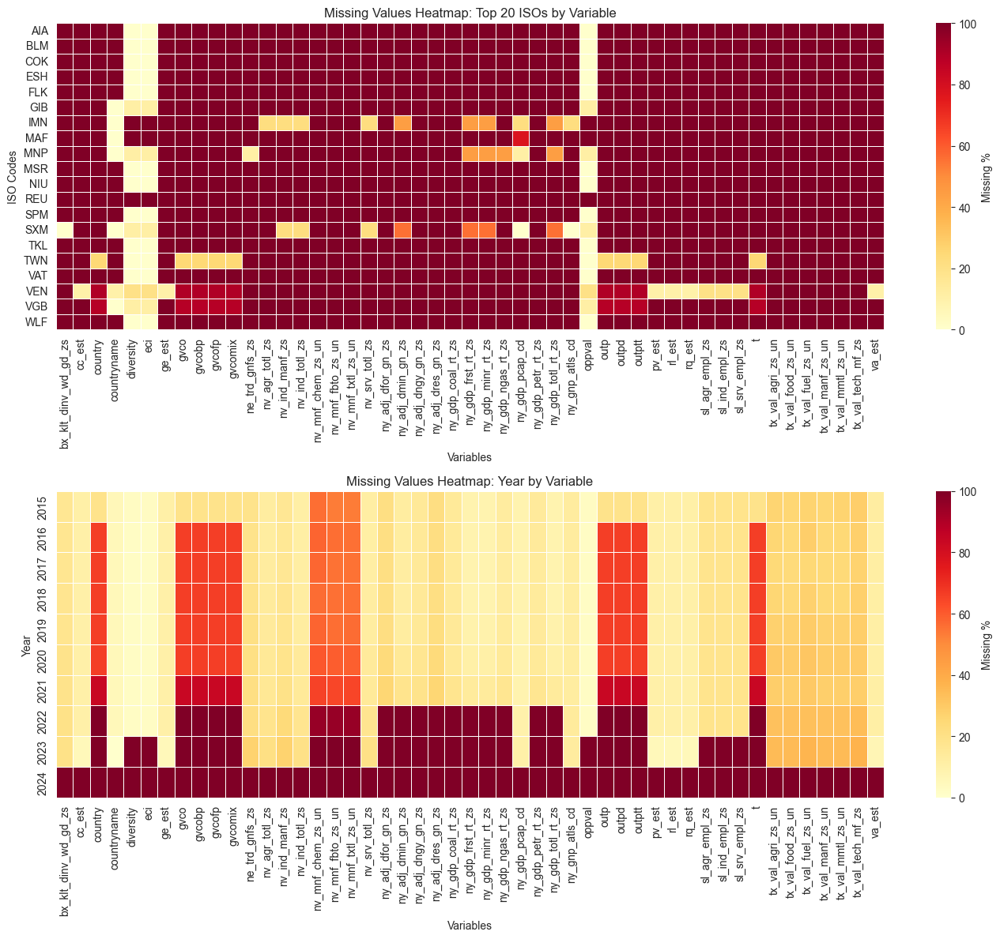


6. Missing Values by ISO-Year Combination:

Countries with biggest changes (2015 to 2024):

Most improved (reduced missing %):
ISO  Missing_2015  Missing_2024    Change
VEN     55.102041         100.0 44.897959

Most deteriorated (increased missing %):
ISO  Missing_2015  Missing_2024    Change
VEN     55.102041         100.0 44.897959

7. Data Completeness Summary

Overall Statistics:
  Total data cells: 99,176
  Complete cells: 65,881 (66.4%)
  Missing cells: 33,295 (33.6%)
  Number of ISOs: 227
  Number of years: 10
  Year range: 2015 - 2024
  Number of variables: 49


In [67]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def analyze_missing_values(df, iso_column='iso', year_column='year'):
    
    # Ensure ISO column exists
    if iso_column not in df.columns:
        raise ValueError(f"Column '{iso_column}' not found in DataFrame")
    
    # Check if year analysis is requested
    analyze_years = year_column and year_column in df.columns
    
    # Get all columns except ISO and year
    id_columns = [iso_column]
    if analyze_years:
        id_columns.append(year_column)
    variable_columns = [col for col in df.columns if col not in id_columns]
    
    # 1. Missing values count by ISO
    print("=" * 60)
    print("MISSING VALUES ANALYSIS BY ISO")
    print("=" * 60)
    
    missing_by_iso = pd.DataFrame()
    missing_by_iso['ISO'] = df[iso_column].unique()
    
    # Calculate missing values for each ISO
    missing_counts = []
    missing_percentages = []
    
    for iso in missing_by_iso['ISO']:
        iso_data = df[df[iso_column] == iso][variable_columns]
        missing_count = iso_data.isnull().sum().sum()
        total_values = len(variable_columns) * len(iso_data)
        missing_pct = (missing_count / total_values * 100) if total_values > 0 else 0
        
        missing_counts.append(missing_count)
        missing_percentages.append(missing_pct)
    
    missing_by_iso['Total_Missing'] = missing_counts
    missing_by_iso['Missing_Percentage'] = missing_percentages
    missing_by_iso = missing_by_iso.sort_values('Missing_Percentage', ascending=False)
    
    print("\n1. Summary of Missing Values by ISO:")
    print(missing_by_iso.head(10).to_string(index=False))
    if len(missing_by_iso) > 10:
        print(f"... showing top 10 of {len(missing_by_iso)} ISOs")
    
    # 2. Missing values by Year (if year column exists)
    missing_by_year = None
    if analyze_years:
        print("\n" + "=" * 60)
        print("MISSING VALUES ANALYSIS BY YEAR")
        print("=" * 60)
        
        missing_by_year = pd.DataFrame()
        missing_by_year['Year'] = sorted(df[year_column].unique())
        
        missing_counts_year = []
        missing_percentages_year = []
        num_countries_year = []
        
        for year in missing_by_year['Year']:
            year_data = df[df[year_column] == year][variable_columns]
            missing_count = year_data.isnull().sum().sum()
            total_values = len(variable_columns) * len(year_data)
            missing_pct = (missing_count / total_values * 100) if total_values > 0 else 0
            num_countries = df[df[year_column] == year][iso_column].nunique()
            
            missing_counts_year.append(missing_count)
            missing_percentages_year.append(missing_pct)
            num_countries_year.append(num_countries)
        
        missing_by_year['Total_Missing'] = missing_counts_year
        missing_by_year['Missing_Percentage'] = missing_percentages_year
        missing_by_year['Num_Countries'] = num_countries_year
        
        print("\n2. Summary of Missing Values by Year:")
        print(missing_by_year.to_string(index=False))
        
        # Plot missing values trend over time
        if len(missing_by_year) > 1:
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
            
            # Missing percentage over time
            ax1.plot(missing_by_year['Year'], missing_by_year['Missing_Percentage'], 
                    marker='o', linewidth=2, markersize=6)
            ax1.set_xlabel('Year')
            ax1.set_ylabel('Missing Values (%)')
            ax1.set_title('Missing Data Percentage Over Time')
            ax1.grid(True, alpha=0.3)
            
            # Number of countries over time
            ax2.bar(missing_by_year['Year'], missing_by_year['Num_Countries'], 
                   color='steelblue', alpha=0.7)
            ax2.set_xlabel('Year')
            ax2.set_ylabel('Number of Countries')
            ax2.set_title('Data Coverage: Countries per Year')
            ax2.grid(True, alpha=0.3, axis='y')
            
            plt.tight_layout()
            plt.show()
    
    # 3. Detailed missing values by ISO and variable
    print("\n" + "=" * 60)
    print("3. Detailed Missing Values by ISO and Variable:")
    print("=" * 60)
    
    detailed_missing = pd.DataFrame()
    
    for iso in df[iso_column].unique():
        iso_data = df[df[iso_column] == iso][variable_columns]
        missing_per_var = iso_data.isnull().sum()
        total_obs = len(iso_data)
        missing_pct_per_var = (missing_per_var / total_obs * 100) if total_obs > 0 else 0
        
        iso_summary = pd.DataFrame({
            'ISO': iso,
            'Variable': missing_per_var.index,
            'Missing_Count': missing_per_var.values,
            'Total_Observations': total_obs,
            'Missing_Pct': missing_pct_per_var
        })
        
        detailed_missing = pd.concat([detailed_missing, iso_summary], ignore_index=True)
    
    # Show summary of variables with most missing values
    var_missing_summary = detailed_missing.groupby('Variable').agg({
        'Missing_Count': 'sum',
        'Missing_Pct': 'mean'
    }).round(2)
    var_missing_summary = var_missing_summary.sort_values('Missing_Pct', ascending=False)
    
    print("\nVariables with highest missing rates (averaged across ISOs):")
    print(var_missing_summary.head(10).to_string())
    
    # 4. Missing values by Year and Variable (if year column exists)
    detailed_missing_year = None
    if analyze_years:
        print("\n" + "=" * 60)
        print("4. Missing Values by Year and Variable:")
        print("=" * 60)
        
        detailed_missing_year = pd.DataFrame()
        
        for year in sorted(df[year_column].unique()):
            year_data = df[df[year_column] == year][variable_columns]
            missing_per_var = year_data.isnull().sum()
            total_obs = len(year_data)
            missing_pct_per_var = (missing_per_var / total_obs * 100) if total_obs > 0 else 0
            
            year_summary = pd.DataFrame({
                'Year': year,
                'Variable': missing_per_var.index,
                'Missing_Count': missing_per_var.values,
                'Total_Observations': total_obs,
                'Missing_Pct': missing_pct_per_var
            })
            
            detailed_missing_year = pd.concat([detailed_missing_year, year_summary], ignore_index=True)
        
        # Create pivot table for year-variable missing rates
        pivot_year_var = pd.pivot_table(
            detailed_missing_year,
            values='Missing_Pct',
            index='Year',
            columns='Variable',
            fill_value=0
        )
        
        # Show summary
        print("\nVariables with changing missing rates over time:")
        for var in variable_columns[:5]:  # Show first 5 variables as example
            var_trend = pivot_year_var[var] if var in pivot_year_var.columns else pd.Series()
            if not var_trend.empty and var_trend.std() > 5:  # Only show if substantial variation
                print(f"\n{var}:")
                print(f"  Min missing: {var_trend.min():.1f}% (Year {var_trend.idxmin()})")
                print(f"  Max missing: {var_trend.max():.1f}% (Year {var_trend.idxmax()})")
                print(f"  Std deviation: {var_trend.std():.1f}%")
    
    # 5. Create comprehensive heatmaps
    print("\n" + "=" * 60)
    print("5. Missing Values Heatmaps")
    print("=" * 60)
    
    # ISO-Variable heatmap
    pivot_iso_var = pd.pivot_table(
        detailed_missing,
        values='Missing_Pct',
        index='ISO',
        columns='Variable',
        fill_value=0
    )
    
    # Create figure with subplots
    num_plots = 2 if analyze_years else 1
    fig, axes = plt.subplots(num_plots, 1, figsize=(14, 6*num_plots))
    
    if num_plots == 1:
        axes = [axes]
    
    # Plot 1: ISO-Variable heatmap (top 20 ISOs with most missing)
    top_missing_isos = missing_by_iso.head(20)['ISO'].tolist()
    pivot_subset = pivot_iso_var.loc[pivot_iso_var.index.isin(top_missing_isos)]
    
    sns.heatmap(pivot_subset, 
               cmap='YlOrRd', 
               cbar_kws={'label': 'Missing %'},
               fmt='.1f',
               linewidths=0.5,
               ax=axes[0])
    axes[0].set_title('Missing Values Heatmap: Top 20 ISOs by Variable')
    axes[0].set_xlabel('Variables')
    axes[0].set_ylabel('ISO Codes')
    
    # Plot 2: Year-Variable heatmap (if applicable)
    if analyze_years and detailed_missing_year is not None:
        pivot_year_var = pd.pivot_table(
            detailed_missing_year,
            values='Missing_Pct',
            index='Year',
            columns='Variable',
            fill_value=0
        )
        
        sns.heatmap(pivot_year_var, 
                   cmap='YlOrRd', 
                   cbar_kws={'label': 'Missing %'},
                   fmt='.1f',
                   linewidths=0.5,
                   ax=axes[1])
        axes[1].set_title('Missing Values Heatmap: Year by Variable')
        axes[1].set_xlabel('Variables')
        axes[1].set_ylabel('Year')
    
    plt.tight_layout()
    plt.show()
    
    # 6. ISO-Year analysis (if year column exists)
    missing_by_iso_year = None
    if analyze_years:
        print("\n" + "=" * 60)
        print("6. Missing Values by ISO-Year Combination:")
        print("=" * 60)
        
        missing_by_iso_year = []
        
        for iso in df[iso_column].unique():
            for year in sorted(df[year_column].unique()):
                iso_year_data = df[(df[iso_column] == iso) & (df[year_column] == year)][variable_columns]
                
                if len(iso_year_data) > 0:
                    missing_count = iso_year_data.isnull().sum().sum()
                    total_values = len(variable_columns) * len(iso_year_data)
                    missing_pct = (missing_count / total_values * 100) if total_values > 0 else 0
                    
                    missing_by_iso_year.append({
                        'ISO': iso,
                        'Year': year,
                        'Total_Missing': missing_count,
                        'Missing_Percentage': missing_pct
                    })
        
        missing_by_iso_year = pd.DataFrame(missing_by_iso_year)
        
        # Show countries with most improvement/deterioration
        if len(missing_by_iso_year) > 0:
            iso_year_pivot = pd.pivot_table(
                missing_by_iso_year,
                values='Missing_Percentage',
                index='ISO',
                columns='Year',
                fill_value=np.nan
            )
            
            # Calculate change from first to last year
            available_years = sorted(iso_year_pivot.columns)
            if len(available_years) > 1:
                first_year = available_years[0]
                last_year = available_years[-1]
                
                change_df = pd.DataFrame({
                    'ISO': iso_year_pivot.index,
                    f'Missing_{first_year}': iso_year_pivot[first_year],
                    f'Missing_{last_year}': iso_year_pivot[last_year],
                    'Change': iso_year_pivot[last_year] - iso_year_pivot[first_year]
                })
                
                change_df = change_df.dropna()
                
                print(f"\nCountries with biggest changes ({first_year} to {last_year}):")
                print("\nMost improved (reduced missing %):")
                print(change_df.nsmallest(5, 'Change')[['ISO', f'Missing_{first_year}', 
                                                         f'Missing_{last_year}', 'Change']].to_string(index=False))
                
                print("\nMost deteriorated (increased missing %):")
                print(change_df.nlargest(5, 'Change')[['ISO', f'Missing_{first_year}', 
                                                       f'Missing_{last_year}', 'Change']].to_string(index=False))
    
    # 7. Completeness report
    print("\n" + "=" * 60)
    print("7. Data Completeness Summary")
    print("=" * 60)
    
    total_cells = len(df) * len(variable_columns)
    total_missing = df[variable_columns].isnull().sum().sum()
    total_complete = total_cells - total_missing
    
    print(f"\nOverall Statistics:")
    print(f"  Total data cells: {total_cells:,}")
    print(f"  Complete cells: {total_complete:,} ({100*total_complete/total_cells:.1f}%)")
    print(f"  Missing cells: {total_missing:,} ({100*total_missing/total_cells:.1f}%)")
    print(f"  Number of ISOs: {df[iso_column].nunique()}")
    if analyze_years:
        print(f"  Number of years: {df[year_column].nunique()}")
        print(f"  Year range: {df[year_column].min()} - {df[year_column].max()}")
    print(f"  Number of variables: {len(variable_columns)}")
    
    # Compile results
    results = {
        'missing_by_iso': missing_by_iso,
        'missing_by_year': missing_by_year,
        'detailed_missing': detailed_missing,
        'detailed_missing_year': detailed_missing_year,
        'missing_by_iso_year': missing_by_iso_year,
        'pivot_iso_var': pivot_iso_var
    }
    
    return results

def export_missing_analysis(results, output_prefix='wbi_missing'):
    """
    Export missing values analysis to CSV files
    
    Parameters:
    -----------
    results : dict
        Results from analyze_missing_values function
    output_prefix : str
        Prefix for output file names
    """
    
    # Export to CSV files
    results['missing_by_iso'].to_csv(f'{output_prefix}_by_iso.csv', index=False)
    
    if results['missing_by_year'] is not None:
        results['missing_by_year'].to_csv(f'{output_prefix}_by_year.csv', index=False)
    
    results['detailed_missing'].to_csv(f'{output_prefix}_detailed.csv', index=False)
    
    if results['detailed_missing_year'] is not None:
        results['detailed_missing_year'].to_csv(f'{output_prefix}_by_year_variable.csv', index=False)
    
    if results['missing_by_iso_year'] is not None:
        results['missing_by_iso_year'].to_csv(f'{output_prefix}_by_iso_year.csv', index=False)
    
    results['pivot_iso_var'].to_csv(f'{output_prefix}_heatmap.csv')
    
    print("\n" + "=" * 60)
    print("Results exported to:")
    print(f"  - {output_prefix}_by_iso.csv")
    if results['missing_by_year'] is not None:
        print(f"  - {output_prefix}_by_year.csv")
        print(f"  - {output_prefix}_by_year_variable.csv")
        print(f"  - {output_prefix}_by_iso_year.csv")
    print(f"  - {output_prefix}_detailed.csv")
    print(f"  - {output_prefix}_heatmap.csv")
    print("=" * 60)


results = analyze_missing_values(wbi_gvc, iso_column='iso', year_column='year')

Given this analysis we want to omit variables which are relatively less important and have lots of missing values. Here is a list:

## **Handling Missing Values**

https://medium.com/@ajayverma23/data-imputation-a-comprehensive-guide-to-handling-missing-values-b5c7d11c3488

In [68]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler

In [69]:
X = wbi1525.drop(columns=["year", "iso", "countryname"])
scaler = StandardScaler()
scaled = scaler.fit_transform(X)
X = pd.DataFrame(scaled, columns= wbi1525.drop(columns=["year", "iso", "countryname"]).columns)

X


,bx_klt_dinv_wd_gd_zs,cc_est,ge_est,ne_trd_gnfs_zs,nv_agr_totl_zs,nv_ind_manf_zs,nv_ind_totl_zs,nv_mnf_chem_zs_un,nv_mnf_fbto_zs_un,nv_mnf_txtl_zs_un,nv_srv_totl_zs,ny_adj_dfor_gn_zs,ny_adj_dmin_gn_zs,ny_adj_dngy_gn_zs,ny_adj_dres_gn_zs,ny_gdp_coal_rt_zs,ny_gdp_frst_rt_zs,ny_gdp_minr_rt_zs,ny_gdp_ngas_rt_zs,ny_gdp_pcap_cd,ny_gdp_petr_rt_zs,ny_gdp_totl_rt_zs,ny_gnp_atls_cd,pv_est,rl_est,rq_est,sl_agr_empl_zs,sl_ind_empl_zs,sl_srv_empl_zs,tx_val_agri_zs_un,tx_val_food_zs_un,tx_val_fuel_zs_un,tx_val_manf_zs_un,tx_val_mmtl_zs_un,tx_val_tech_mf_zs,va_est,eci,oppval,diversity
0,-0.114801,1.268226,0.881376,0.924620,-1.031498,-1.112303,-1.093122,NaN,NaN,NaN,1.732017,-0.386939,-0.297007,-0.368837,-0.606421,-0.165521,-0.457314,-0.319478,-0.225709,0.315520,-0.350641,-0.607981,-0.225332,1.239610,1.254176,1.393276,NaN,NaN,NaN,-0.421640,1.356742,-0.607370,-0.318983,-0.307225,-0.450697,1.305457,0.668179,0.356603,-0.322047
1,-0.088974,-1.324904,-1.368683,NaN,1.076274,-0.034610,-0.261102,NaN,NaN,NaN,-0.301910,-0.311798,-0.295996,-0.356328,-0.555994,-0.006955,-0.368978,-0.318577,-0.225019,-0.652414,-0.348433,-0.551884,-0.216486,-2.526432,-1.489640,-0.987167,0.959010,0.152626,-1.206812,1.490656,0.929901,-0.471311,-0.855055,-0.539009,NaN,-1.093933,-1.226375,-1.008895,-0.523376
2,0.058056,-1.397640,-0.899319,-0.494781,-0.100356,-0.823459,1.445906,NaN,NaN,NaN,-0.661164,-0.206742,-0.297007,1.953918,1.312118,-0.165521,-0.295740,-0.319478,-0.206339,-0.557094,1.709192,0.988243,-0.170775,-0.472912,-1.004014,-0.831786,1.526369,-1.518670,-1.170504,-0.429297,-1.012666,3.316460,-1.305787,-0.386636,0.144751,-1.153663,-1.623937,-1.225021,-1.089612
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.028850,0.289468,-0.422711
4,0.023584,-0.518406,0.059502,-0.342266,0.988975,-0.825333,-0.292155,-0.336830,-0.479607,3.533235,-0.847681,-0.326038,-0.274346,-0.143327,-0.390910,-0.159709,-0.399057,-0.289680,-0.219583,-0.530499,-0.115388,-0.400107,-0.220272,0.372581,-0.292918,0.207640,0.805787,-0.111842,-0.911746,-0.133844,-0.797654,-0.247296,0.375768,-0.085766,-0.710758,0.184970,-0.626290,0.022973,0.219023
5,NaN,1.172020,1.776527,NaN,-0.980301,-1.095685,-1.307483,NaN,NaN,NaN,1.694984,NaN,NaN,NaN,NaN,NaN,-0.458051,-0.319478,NaN,0.718518,NaN,-0.608268,NaN,1.395075,1.540279,0.932840,NaN,NaN,NaN,-0.227332,-0.980985,-0.613761,1.584594,-0.298186,0.927796,1.225658,0.782700,0.719563,0.042861
6,-0.036723,1.055310,1.535742,1.329204,-0.958811,-0.343295,1.568370,-0.646069,-0.935162,-0.323490,-0.090947,-0.387684,-0.297007,0.556086,0.118611,-0.165521,-0.457985,-0.319478,0.076841,0.894164,1.771350,1.077169,-0.017819,0.778256,0.641093,1.131348,-1.009462,1.542589,0.544881,-0.423871,-0.948230,0.959101,-1.041422,-0.297132,-0.424728,-1.088721,-0.049364,-0.288180,-0.284298
7,-0.073212,-0.554393,-0.017723,-1.186166,-0.505709,0.345255,-0.172429,0.979642,0.227681,0.318221,-0.099363,-0.387753,-0.262527,-0.192338,-0.459395,-0.165425,-0.427414,-0.284796,-0.146613,-0.180406,-0.238260,-0.474269,0.048347,0.040308,-0.721942,-0.866187,-0.742217,0.359653,0.730512,-0.305274,1.393281,-0.509448,-0.443807,-0.421228,-0.118739,0.440420,-0.128606,0.713472,0.621681
8,-0.076563,-0.582766,-0.300674,-0.344301,0.727612,-0.339130,0.047799,-0.710221,2.325087,-0.637982,-0.696279,-0.304913,-0.123656,-0.368837,-0.516962,-0.165521,-0.376613,-0.094905,-0.225709,-0.546350,-0.350641,-0.517074,-0.220726,-0.224775,-0.435808,0.222602,1.309453,-0.529926,-1.333353,-0.359220,0.133805,-0.368037,-0.850751,2.252302,-0.397447,-0.510691,-0.194150,-0.369586,-0.158468
9,NaN,1.172020,0.475681,1.208234,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.165521,-0.458051,-0.319478,-0.225709,-0.214679,-0.350641,-0.608268,NaN,1.181155,1.312576,0.184574,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.723664,0.057504,-0.548542


A caveat to this appraoch is that the dimensions are 36, which means KNN will be less effective in finding the the nearest neighbours as in the 36th dimensional space points are too far away.

In [70]:
imputer = KNNImputer(n_neighbors=6)
X_imputed = imputer.fit_transform(X)
X_imputed = pd.DataFrame(X_imputed, columns= wbi1525.drop(columns=["year", "iso", "countryname"]).columns)

wbi1525_imp = X_imputed

wbi1525_imp.insert(loc = 0,
        column = 'year',
        value = list(wbi1525['year']))

wbi1525_imp.insert(loc = 1,
        column = 'iso',
        value = list(wbi1525['iso']))

wbi1525_imp.insert(loc = 2,
        column = 'countryname',
        value = list(wbi1525['countryname']))

wbi1525_imp

,year,iso,countryname,bx_klt_dinv_wd_gd_zs,cc_est,ge_est,ne_trd_gnfs_zs,nv_agr_totl_zs,nv_ind_manf_zs,nv_ind_totl_zs,nv_mnf_chem_zs_un,nv_mnf_fbto_zs_un,nv_mnf_txtl_zs_un,nv_srv_totl_zs,ny_adj_dfor_gn_zs,ny_adj_dmin_gn_zs,ny_adj_dngy_gn_zs,ny_adj_dres_gn_zs,ny_gdp_coal_rt_zs,ny_gdp_frst_rt_zs,ny_gdp_minr_rt_zs,ny_gdp_ngas_rt_zs,ny_gdp_pcap_cd,ny_gdp_petr_rt_zs,ny_gdp_totl_rt_zs,ny_gnp_atls_cd,pv_est,rl_est,rq_est,sl_agr_empl_zs,sl_ind_empl_zs,sl_srv_empl_zs,tx_val_agri_zs_un,tx_val_food_zs_un,tx_val_fuel_zs_un,tx_val_manf_zs_un,tx_val_mmtl_zs_un,tx_val_tech_mf_zs,va_est,eci,oppval,diversity
0,2015,ABW,Aruba,-0.114801,1.268226e+00,8.813763e-01,9.246201e-01,-1.031498e+00,-1.112303e+00,-1.093122e+00,8.911597e-01,7.208503e-01,4.471480e-01,1.732017e+00,-0.386939,-0.297007,-3.688366e-01,-6.064206e-01,-1.655213e-01,-4.573145e-01,-3.194780e-01,-2.257086e-01,3.155205e-01,-3.506413e-01,-6.079813e-01,-2.253322e-01,1.239610e+00,1.254176e+00,1.393276e+00,-1.003292e+00,-2.936245e-01,1.319630e+00,-4.216396e-01,1.356742e+00,-6.073697e-01,-3.189833e-01,-3.072252e-01,-4.506972e-01,1.305457e+00,6.681786e-01,3.566026e-01,-3.220471e-01
1,2015,AFG,Afghanistan,-0.088974,-1.324904e+00,-1.368683e+00,-1.016547e+00,1.076274e+00,-3.460950e-02,-2.611020e-01,-5.292124e-01,1.032595e+00,2.389498e+00,-3.019098e-01,-0.311798,-0.295996,-3.563279e-01,-5.559941e-01,-6.955056e-03,-3.689780e-01,-3.185773e-01,-2.250187e-01,-6.524139e-01,-3.484330e-01,-5.518837e-01,-2.164862e-01,-2.526432e+00,-1.489640e+00,-9.871672e-01,9.590099e-01,1.526263e-01,-1.206812e+00,1.490656e+00,9.299013e-01,-4.713110e-01,-8.550549e-01,-5.390090e-01,-6.955107e-01,-1.093933e+00,-1.226375e+00,-1.008895e+00,-5.233756e-01
2,2015,AGO,Angola,0.058056,-1.397640e+00,-8.993189e-01,-4.947810e-01,-1.003557e-01,-8.234590e-01,1.445906e+00,-8.822955e-01,1.900946e-02,-4.511172e-01,-6.611642e-01,-0.206742,-0.297007,1.953918e+00,1.312118e+00,-1.655213e-01,-2.957404e-01,-3.194780e-01,-2.063389e-01,-5.570937e-01,1.709192e+00,9.882426e-01,-1.707751e-01,-4.729125e-01,-1.004014e+00,-8.317856e-01,1.526369e+00,-1.518670e+00,-1.170504e+00,-4.292966e-01,-1.012666e+00,3.316460e+00,-1.305787e+00,-3.866361e-01,1.447506e-01,-1.153663e+00,-1.623937e+00,-1.225021e+00,-1.089612e+00
3,2015,AIA,NaN,0.707547,1.147045e+00,7.819033e-01,8.844924e-01,-7.439085e-01,-1.059775e+00,-1.167333e+00,5.001669e-02,-7.578850e-01,-7.500469e-01,1.398141e+00,0.054497,-0.297007,-3.688366e-01,-3.693686e-01,-1.655213e-01,-4.423207e-01,-3.194780e-01,-2.257086e-01,1.904173e-01,-3.506413e-01,-6.021454e-01,-2.246157e-01,1.267122e+00,1.183099e+00,6.669964e-01,-5.641384e-01,-4.384915e-01,8.584263e-01,-4.130228e-01,1.729400e-01,-1.743658e-01,3.949224e-01,-3.257114e-01,5.838143e-01,1.135560e+00,1.028850e+00,2.894680e-01,-4.227113e-01
4,2015,ALB,Albania,0.023584,-5.184058e-01,5.950211e-02,-3.422657e-01,9.889748e-01,-8.253332e-01,-2.921555e-01,-3.368302e-01,-4.796070e-01,3.533235e+00,-8.476809e-01,-0.326038,-0.274346,-1.433267e-01,-3.909097e-01,-1.597087e-01,-3.990567e-01,-2.896800e-01,-2.195833e-01,-5.304988e-01,-1.153878e-01,-4.001066e-01,-2.202719e-01,3.725807e-01,-2.929184e-01,2.076403e-01,8.057874e-01,-1.118419e-01,-9.117460e-01,-1.338442e-01,-7.976535e-01,-2.472963e-01,3.757682e-01,-8.576611e-02,-7.107583e-01,1.849700e-01,-6.262904e-01,2.297289e-02,2.190235e-01
5,2015,AND,Andorra,-0.048844,1.172020e+00,1.776527e+00,9.275597e-01,-9.803007e-01,-1.095685e+00,-1.307483e+00,8.019698e-02,-7.997081e-01,-6.723385e-01,1.694984e+00,-0.385868,-0.297007,-3.688366e-01,-6.029135e-01,-1.655213e-01,-4.580505e-01,-3.194780e-01,-2.257086e-01,7.185182e-01,-3.506413e-01,-6.082677e-01,-2.254970e-01,1.395075e+00,1.540279e+00,9.328400e-01,-1.044451e+00,-4.093406e-01,1.417897e+00,-2.273321e-01,-9.809851e-01,-6.137607e-01,1.584594e+00,-2.981859e-01,9.277955e-01,1.225658e+00,7.827004e-01,7.195634e-01,4.286096e-02
6,2015,ARE,United Arab Emirates,-0.036723,1.055310e+00,1.535742e+00,1.329204e+00,-9.588107e-01,-3.432947e-01,1.568370e+00,-6.460689e-01,-9.351620e-01,-3.234896e-01,-

In [71]:
wbi_agg = wbi1525_imp.groupby(['iso', 'countryname'])[wbi1525_imp.drop(columns=['iso','year','countryname']).columns].mean().reset_index()
wbi_agg

,iso,countryname,bx_klt_dinv_wd_gd_zs,cc_est,ge_est,ne_trd_gnfs_zs,nv_agr_totl_zs,nv_ind_manf_zs,nv_ind_totl_zs,nv_mnf_chem_zs_un,nv_mnf_fbto_zs_un,nv_mnf_txtl_zs_un,nv_srv_totl_zs,ny_adj_dfor_gn_zs,ny_adj_dmin_gn_zs,ny_adj_dngy_gn_zs,ny_adj_dres_gn_zs,ny_gdp_coal_rt_zs,ny_gdp_frst_rt_zs,ny_gdp_minr_rt_zs,ny_gdp_ngas_rt_zs,ny_gdp_pcap_cd,ny_gdp_petr_rt_zs,ny_gdp_totl_rt_zs,ny_gnp_atls_cd,pv_est,rl_est,rq_est,sl_agr_empl_zs,sl_ind_empl_zs,sl_srv_empl_zs,tx_val_agri_zs_un,tx_val_food_zs_un,tx_val_fuel_zs_un,tx_val_manf_zs_un,tx_val_mmtl_zs_un,tx_val_tech_mf_zs,va_est,eci,oppval,diversity
0,ABW,Aruba,-0.055940,1.083713,0.993704,0.969811,-1.017317,-1.180952,-1.167378,1.207953,0.630906,0.558208,1.702109,-0.386854,-0.297007,-0.368837,-0.606375,-0.165521,-0.457106,-0.170717,-0.225709,0.363488,-0.350641,-0.568488,-0.225179,1.382122,1.282946,1.071992,-0.972446,-0.230522,1.256023,-0.419875,1.168956,-0.612623,-0.281375,-0.086647,-0.364525,1.223070,0.715859,0.125883,-0.504734
1,AFG,Afghanistan,-0.092285,-1.340293,-1.554541,-0.722034,1.833751,-0.595428,-0.952675,-0.409497,1.095769,1.538050,-0.321527,-0.311872,-0.280105,-0.341981,-0.540619,0.029770,-0.354714,-0.303876,-0.192717,-0.655808,-0.321888,-0.506141,-0.217528,-2.594369,-1.647830,-1.214516,0.902661,-0.094333,-1.034542,1.404788,1.314740,-0.205333,-1.160942,-0.486243,-0.732032,-1.245006,-1.216552,-0.709247,-0.399409
2,AGO,Angola,-0.153659,-1.017786,-1.015504,-0.487431,0.052178,-0.684407,1.739707,-0.739705,-0.057665,-0.450770,-1.044230,-0.139947,-0.297007,4.008804,2.959665,-0.165521,-0.240474,-0.319478,-0.029673,-0.589583,3.466167,2.377601,-0.190940,-0.435649,-0.990588,-0.791152,1.425474,-1.599825,-1.015814,-0.418637,-1.009498,3.328059,-1.343041,-0.340296,0.715714,-0.901159,-1.262760,-1.130097,-1.024367
3,ALB,Albania,0.009027,-0.473472,0.065020,-0.281469,0.835803,-0.695176,-0.234167,-0.492639,-0.428739,3.739025,-0.853145,-0.337236,-0.282364,-0.206143,-0.448291,-0.149263,-0.410400,-0.295041,-0.218225,-0.470254,-0.164440,-0.440484,-0.218859,0.264952,-0.293899,0.237751,0.629854,0.067362,-0.778602,-0.322617,-0.629772,-0.472704,0.320639,-0.314216,-0.804591,0.177312,-0.410401,0.150196,0.110437
4,AND,Andorra,-0.050531,1.231710,1.771681,1.082046,-0.979160,-1.097280,-1.192023,0.158890,-0.747772,-0.675561,1.673539,-0.385780,-0.297007,-0.365620,-0.599766,-0.165487,-0.458035,-0.319478,-0.225225,0.817115,-0.349270,-0.608262,-0.133345,1.523260,1.563540,1.236232,-1.047630,-0.292632,1.371956,-0.275175,-0.994704,-0.614479,1.696213,-0.420420,1.011527,1.131914,1.005065,0.763137,0.026317
5,ARE,United Arab Emirates,-0.035869,1.122118,1.443773,1.478399,-0.953209,-0.281321,1.724310,-0.730279,-0.901890,-0.336370,-0.237338,-0.387411,-0.297007,0.654889,0.196250,-0.165521,-0.457936,-0.178750,0.151913,0.913368,1.860845,1.208884,-0.013048,0.682417,0.824309,1.046081,-1.025307,1.448796,0.603693,-0.424701,-0.909163,1.869112,-1.037170,-0.297150,-0.411482,-1.100018,-0.015097,-0.424181,-0.464655
6,ARG,Argentina,-0.074806,-0.284176,-0.089982,-1.079009,-0.433984,0.394771,-0.168010,1.194965,0.295519,-0.028018,-0.159440,-0.387727,-0.190290,-0.131564,-0.392792,-0.165326,-0.415397,-0.219588,-0.127770,-0.232791,-0.194787,-0.413040,0.037711,0.029404,-0.396604,-0.456533,-0.760590,0.151929,0.840860,-0.316643,1.339124,-0.449027,-0.715981,-0.527892,-0.322141,0.564549,-0.293006,0.460785,0.380972
7,ARM,Armenia,-0.068887,-0.242257,-0.232975,-0.061573,0.277763,-0.100456,0.023273,-0.645224,1.521214,-0.333551,-0.321746,-0.316693,0.171100,-0.364450,-0.442636,-0.153268,-0.383982,0.347976,-0.224697,-0.499694,-0.347280,-0.398515,-0.219698,-0.585963,-0.167068,0.212862,1.130093,-0.455005,-1.151713,-0.378498,0.100467,-0.489087,-0.525246,1.705627,-0.038469,-0.138063,-0.161912,-0.336333,-0.129340
8,ASM,American Samoa,-0.045589,1.430536,0.590644,0.956879,-0.932763,-1.066848,-1.094659,0.405665,0.459778,-0.619238,1.389560,-0.385241,-0.296757,-0.367757,-0.603945,-0.165521,-0.457944,-0.319478,-0.225627,-0.121000,-0.350090,-0.607970,-0.224589,1.162869,1

## **SIMPLE CLUSTERING**

In [72]:
from sklearn.cluster import KMeans
from plotnine import *

In [198]:
simple = [
    # GDP
    'ny_gdp_pcap_cd', # GDP per capita (current US$)
    'ny_gnp_atls_cd', # GNI, Atlas method (current US$)

    # Resource Intensity
    'ny_gdp_totl_rt_zs', # Total natural resources rents (% of GDP)
    #'ny_gdp_coal_rt_zs', # Coal rents (% of GDP)
    #'ny_gdp_frst_rt_zs', # Forest rents (% of GDP)
    #'ny_gdp_minr_rt_zs', # Mineral rents (% of GDP)
    #'ny_gdp_ngas_rt_zs', # Natural gas rents (% of GDP)
    #'ny_gdp_petr_rt_zs', # Oil rents (% of GDP)

    # Manufacturing & Industrial Output
    'nv_ind_manf_zs',        # Manufacturing, value added (% of GDP)
    'nv_ind_totl_zs',        # Industry (including construction), value added (% of GDP)
    'tx_val_manf_zs_un',     # Manufactures exports (% of merchandise exports)
    'tx_val_tech_mf_zs',     # High-technology exports (% of manufactured exports)
    'nv_agr_totl_zs',        # Agriculture, forestry, and fishing, value added (% of GDP)
    'nv_srv_totl_zs',        # Services, value added (% of GDP)
    
    #'nv_mnf_chem_zs_un', # Chemicals (% of manufacturing value added)
    #'nv_mnf_fbto_zs_un', # Food, beverages and tobacco (% of manufacturing value added)
    #'nv_mnf_txtl_zs_un', # Textiles and clothing (% of manufacturing value added)

    # Employment
    'sl_ind_empl_zs',       # Employment in industry (% of total employment)
    'sl_srv_empl_zs',       # Employment in services (% of total employment)
    'sl_agr_empl_zs',       # Employment in agriculture (% of total)
    
    # Investment & Capital Formation
    #'bx_klt_dinv_wd_gd_zs', # Foreign direct investment, net inflows (% of GDP)
    
    # Innovation & Technology
    #'gb_xpd_rsdv_gd_zs',    # Research and development expenditure (% of GDP)
    
    # Trade Sophistication
    'ne_trd_gnfs_zs',       # Trade (% of GDP)
    #'tm_tax_mrch_wm_ar_zs', # Tariff Rate
    #'ny_ttf_gnfs_kn',       # Terms of trade
    
    'tx_val_fuel_zs_un', # Fuel exports (% of merchandise exports)
    'tx_val_mmtl_zs_un', # Ores and metals exports (% of merchandise exports)
    #'tx_val_food_zs_un', # Food exports (% of merchandise exports)
    #'tx_val_agri_zs_un', # Agricultural raw materials exports (% of merchandise exports)

    # Economic Complexity & Diversification
    'eci',                   # Economic Complexity Index
    'diversity',             # Export diversity measure
    'oppval',                # Opportunity value (potential for developing new products)
]

In [199]:
wbi_cluster = wbi_agg[simple]
wbi_cluster

,ny_gdp_pcap_cd,ny_gnp_atls_cd,ny_gdp_totl_rt_zs,nv_ind_manf_zs,nv_ind_totl_zs,tx_val_manf_zs_un,tx_val_tech_mf_zs,nv_agr_totl_zs,nv_srv_totl_zs,sl_ind_empl_zs,sl_srv_empl_zs,sl_agr_empl_zs,ne_trd_gnfs_zs,tx_val_fuel_zs_un,tx_val_mmtl_zs_un,eci,diversity,oppval
0,0.363488,-0.225179,-0.568488,-1.180952,-1.167378,-0.281375,-0.364525,-1.017317,1.702109,-0.230522,1.256023,-0.972446,0.969811,-0.612623,-0.086647,0.715859,-0.504734,0.125883
1,-0.655808,-0.217528,-0.506141,-0.595428,-0.952675,-1.160942,-0.732032,1.833751,-0.321527,-0.094333,-1.034542,0.902661,-0.722034,-0.205333,-0.486243,-1.216552,-0.399409,-0.709247
2,-0.589583,-0.190940,2.377601,-0.684407,1.739707,-1.343041,0.715714,0.052178,-1.044230,-1.599825,-1.015814,1.425474,-0.487431,3.328059,-0.340296,-1.262760,-1.024367,-1.130097
3,-0.470254,-0.218859,-0.440484,-0.695176,-0.234167,0.320639,-0.804591,0.835803,-0.853145,0.067362,-0.778602,0.629854,-0.281469,-0.472704,-0.314216,-0.410401,0.110437,0.150196
4,0.817115,-0.133345,-0.608262,-1.097280,-1.192023,1.696213,1.011527,-0.979160,1.673539,-0.292632,1.371956,-1.047630,1.082046,-0.614479,-0.420420,1.005065,0.026317,0.763137
5,0.913368,-0.013048,1.208884,-0.281321,1.724310,-1.037170,-0.411482,-0.953209,-0.237338,1.448796,0.603693,-1.025307,1.478399,1.869112,-0.297150,-0.015097,-0.464655,-0.424181
6,-0.232791,0.037711,-0.413040,0.394771,-0.168010,-0.715981,-0.322141,-0.433984,-0.159440,0.151929,0.840860,-0.760590,-1.079009,-0.449027,-0.527892,-0.293006,0.380972,0.460785
7,-0.499694,-0.219698,-0.398515,-0.100456,0.023273,-0.525246,-0.038469,0.277763,-0.321746,-0.455005,-1.151713,1.130093,-0.061573,-0.489087,1.705627,-0.161912,-0.129340,-0.336333
8,-0.121000,-0.224589,-0.607970,-1.066848,-1.094659,0.105140,-0.115587,-0.932763,1.389560,-0.195498,1.058133,-0.818792,0.956879,-0.517610,-0.450927,0.814851,-0.604932,0.008756
9,-0.027597,-0.225885,-0.608235,-1.216664,-0.493750,-0.381807,-0.829408,-0.850221,0.957363,-0.068350,0.857955,-0.696142,0.480877,-0.615621,-0.370901,0.282908,-0.692082,-0.322025


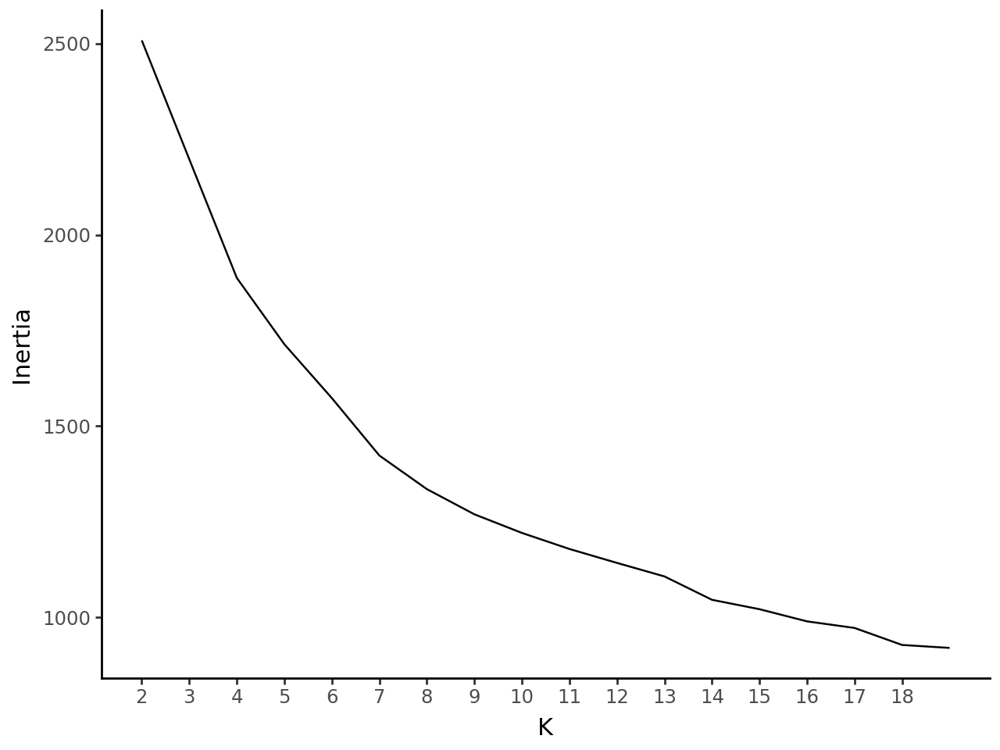

In [200]:
k = range(2,20)
inertia = []

for i in k:
    kmeans = KMeans(n_clusters=i, n_init=20, random_state=421)
    kmeans.fit(wbi_cluster)

    inertia.append(kmeans.inertia_)

d_plot = pd.DataFrame({'inertia':inertia},
             index=k
             ).reset_index()

(
    ggplot(d_plot) +
    geom_line(aes(x='index', y='inertia')) +
    theme_classic() +
    labs(x='K', y='Inertia') +
    scale_x_continuous(breaks=d_plot.index+1)
    )

In [204]:
kmeans_elbow = KMeans(n_clusters=7, n_init=20, random_state=421)
# Fitting and predicting in one line
y_pred= kmeans_elbow.fit_predict(wbi_cluster)

In [205]:
clusters = pd.DataFrame({'iso':wbi_agg['iso'], 'clusters': y_pred})

clusters = pd.merge(clusters, wbi_agg, on='iso')
clusters.head()

,iso,clusters,countryname,bx_klt_dinv_wd_gd_zs,cc_est,ge_est,ne_trd_gnfs_zs,nv_agr_totl_zs,nv_ind_manf_zs,nv_ind_totl_zs,nv_mnf_chem_zs_un,nv_mnf_fbto_zs_un,nv_mnf_txtl_zs_un,nv_srv_totl_zs,ny_adj_dfor_gn_zs,ny_adj_dmin_gn_zs,ny_adj_dngy_gn_zs,ny_adj_dres_gn_zs,ny_gdp_coal_rt_zs,ny_gdp_frst_rt_zs,ny_gdp_minr_rt_zs,ny_gdp_ngas_rt_zs,ny_gdp_pcap_cd,ny_gdp_petr_rt_zs,ny_gdp_totl_rt_zs,ny_gnp_atls_cd,pv_est,rl_est,rq_est,sl_agr_empl_zs,sl_ind_empl_zs,sl_srv_empl_zs,tx_val_agri_zs_un,tx_val_food_zs_un,tx_val_fuel_zs_un,tx_val_manf_zs_un,tx_val_mmtl_zs_un,tx_val_tech_mf_zs,va_est,eci,oppval,diversity
0,ABW,0,Aruba,-0.055940,1.083713,0.993704,0.969811,-1.017317,-1.180952,-1.167378,1.207953,0.630906,0.558208,1.702109,-0.386854,-0.297007,-0.368837,-0.606375,-0.165521,-0.457106,-0.170717,-0.225709,0.363488,-0.350641,-0.568488,-0.225179,1.382122,1.282946,1.071992,-0.972446,-0.230522,1.256023,-0.419875,1.168956,-0.612623,-0.281375,-0.086647,-0.364525,1.223070,0.715859,0.125883,-0.504734
1,AFG,1,Afghanistan,-0.092285,-1.340293,-1.554541,-0.722034,1.833751,-0.595428,-0.952675,-0.409497,1.095769,1.538050,-0.321527,-0.311872,-0.280105,-0.341981,-0.540619,0.029770,-0.354714,-0.303876,-0.192717,-0.655808,-0.321888,-0.506141,-0.217528,-2.594369,-1.647830,-1.214516,0.902661,-0.094333,-1.034542,1.404788,1.314740,-0.205333,-1.160942,-0.486243,-0.732032,-1.245006,-1.216552,-0.709247,-0.399409
2,AGO,2,Angola,-0.153659,-1.017786,-1.015504,-0.487431,0.052178,-0.684407,1.739707,-0.739705,-0.057665,-0.450770,-1.044230,-0.139947,-0.297007,4.008804,2.959665,-0.165521,-0.240474,-0.319478,-0.029673,-0.589583,3.466167,2.377601,-0.190940,-0.435649,-0.990588,-0.791152,1.425474,-1.599825,-1.015814,-0.418637,-1.009498,3.328059,-1.343041,-0.340296,0.715714,-0.901159,-1.262760,-1.130097,-1.024367
3,ALB,5,Albania,0.009027,-0.473472,0.065020,-0.281469,0.835803,-0.695176,-0.234167,-0.492639,-0.428739,3.739025,-0.853145,-0.337236,-0.282364,-0.206143,-0.448291,-0.149263,-0.410400,-0.295041,-0.218225,-0.470254,-0.164440,-0.440484,-0.218859,0.264952,-0.293899,0.237751,0.629854,0.067362,-0.778602,-0.322617,-0.629772,-0.472704,0.320639,-0.314216,-0.804591,0.177312,-0.410401,0.150196,0.110437
4,AND,0,Andorra,-0.050531,1.231710,1.771681,1.082046,-0.979160,-1.097280,-1.192023,0.158890,-0.747772,-0.675561,1.673539,-0.385780,-0.297007,-0.365620,-0.599766,-0.165487,-0.458035,-0.319478,-0.225225,0.817115,-0.349270,-0.608262,-0.133345,1.523260,1.563540,1.236232,-1.047630,-0.292632,1.371956,-0.275175,-0.994704,-0.614479,1.696213,-0.420420,1.011527,1.131914,1.005065,0.763137,0.026317


Creating World Map Visualization...



MAP INFORMATION
Total countries in dataset: 214

Countries/territories that may not appear on the map (typically small islands):

Cluster 0:
  • Curacao
  • American Samoa
  • Greenland
  • Turks and Caicos Islands
  • Marshall Islands
  • New Caledonia
  • Cayman Islands
  • British Virgin Islands
  • Guam
  • Sint Maarten (Dutch part)
  • Northern Mariana Islands
  • Isle of Man
  • Palau
  • Bermuda
  • Virgin Islands (US)
  • Aruba

Cluster 3:
  • Puerto Rico

INTERACTIVE FEATURES:
1. DROPDOWN MENU (top-left): Select a specific cluster to highlight
2. LEGEND (right side):
   - Single-click: Toggle individual cluster on/off
   - Double-click: Isolate that cluster (show only that cluster)
3. HOVER: View country name and cluster assignment

Generating Comprehensive Overview Heatmap...


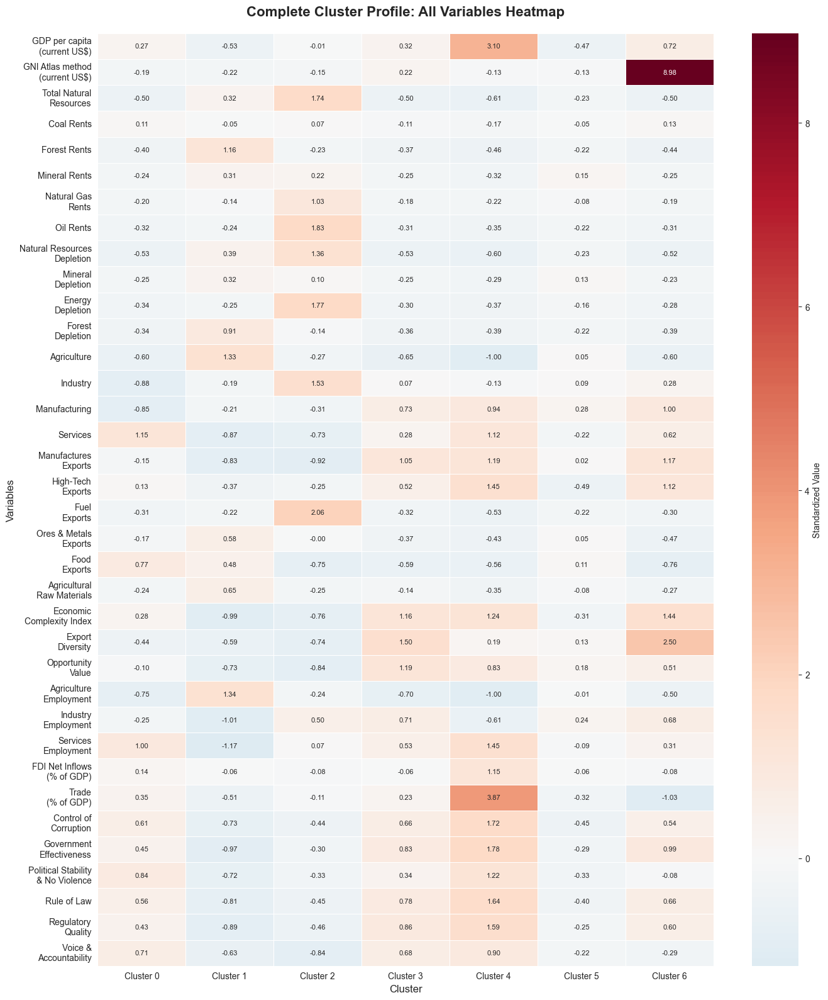


Generating Radar Charts...


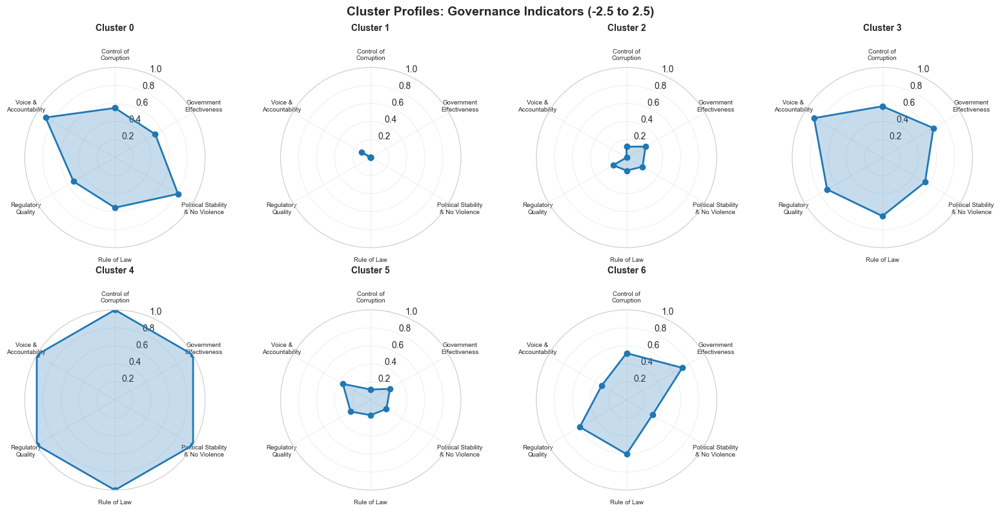

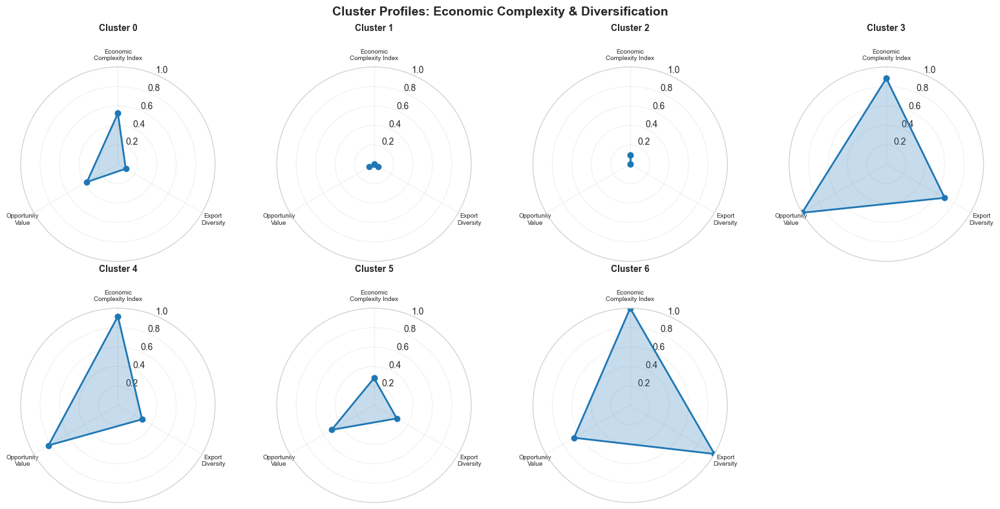

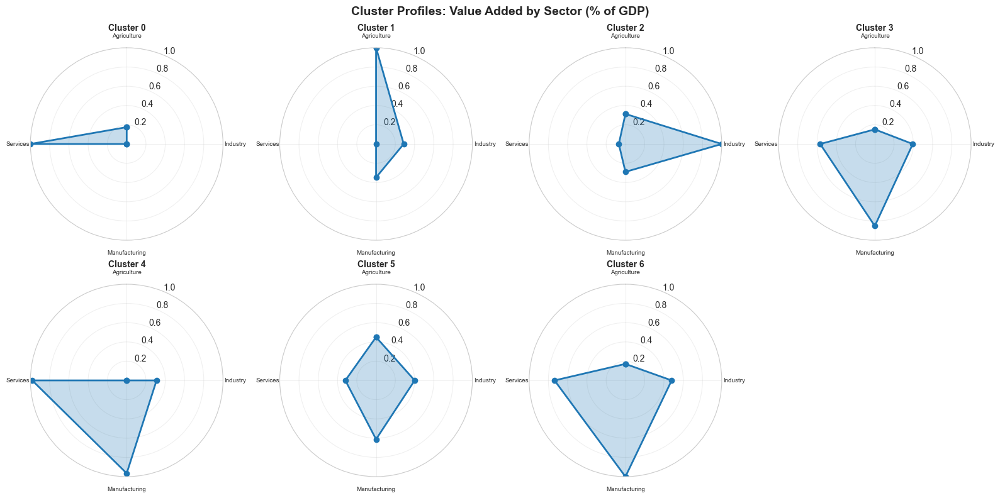

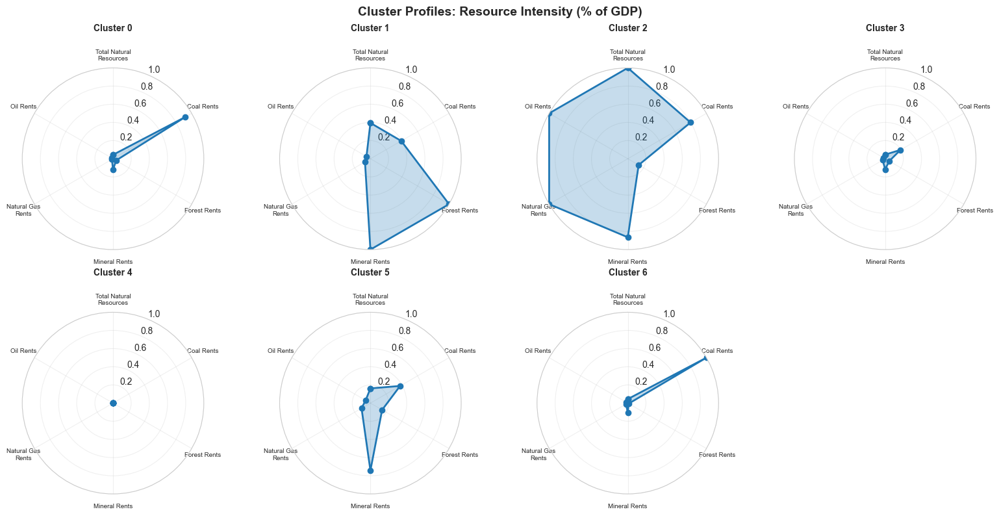


CLUSTER COMPARISON MATRIX - KEY INDICATORS
  Cluster  GDP per capita  Economic Complexity  Manufacturing VA  Services VA  Natural Resources  Gov Effectiveness  FDI Inflows  Export Diversity  Trade Openness
Cluster 0           0.267                0.281            -0.850        1.155             -0.504              0.450        0.141            -0.440           0.352
Cluster 1          -0.525               -0.989            -0.207       -0.867              0.318             -0.973       -0.060            -0.592          -0.506
Cluster 2          -0.007               -0.762            -0.314       -0.728              1.738             -0.303       -0.082            -0.742          -0.108
Cluster 3           0.322                1.156             0.725        0.280             -0.500              0.829       -0.059             1.505           0.234
Cluster 4           3.096                1.237             0.935        1.116             -0.607              1.784        1.151             

In [206]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

# Your dataframe is named 'clusters'
# clusters = pd.read_csv('your_data.csv')  # Load your data

# Set style for better visualization
sns.set_style("whitegrid")

# Define variable groups with themes and proper labels
variable_groups = {
    'GDP & National Income': {
        'vars': ['ny_gdp_pcap_cd', 'ny_gnp_atls_cd'],
        'labels': ['GDP per capita\n(current US$)', 'GNI Atlas method\n(current US$)'],
        'color': 'Blues'
    },
    'Resource Intensity (% of GDP)': {
        'vars': ['ny_gdp_totl_rt_zs', 'ny_gdp_coal_rt_zs', 'ny_gdp_frst_rt_zs', 
                 'ny_gdp_minr_rt_zs', 'ny_gdp_ngas_rt_zs', 'ny_gdp_petr_rt_zs'],
        'labels': ['Total Natural\nResources', 'Coal Rents', 'Forest Rents', 
                   'Mineral Rents', 'Natural Gas\nRents', 'Oil Rents'],
        'color': 'Oranges'
    },
    'Resource Depletion (% of GNI)': {
        'vars': ['ny_adj_dres_gn_zs', 'ny_adj_dmin_gn_zs', 'ny_adj_dngy_gn_zs', 'ny_adj_dfor_gn_zs'],
        'labels': ['Natural Resources\nDepletion', 'Mineral\nDepletion', 'Energy\nDepletion', 'Forest\nDepletion'],
        'color': 'Reds'
    },
    'Value Added by Sector (% of GDP)': {
        'vars': ['nv_agr_totl_zs', 'nv_ind_totl_zs', 'nv_ind_manf_zs', 'nv_srv_totl_zs'],
        'labels': ['Agriculture', 'Industry', 'Manufacturing', 'Services'],
        'color': 'Greens'
    },
    'Export Composition (%)': {
        'vars': ['tx_val_manf_zs_un', 'tx_val_tech_mf_zs', 'tx_val_fuel_zs_un', 
                 'tx_val_mmtl_zs_un', 'tx_val_food_zs_un', 'tx_val_agri_zs_un'],
        'labels': ['Manufactures\nExports', 'High-Tech\nExports', 'Fuel\nExports', 
                   'Ores & Metals\nExports', 'Food\nExports', 'Agricultural\nRaw Materials'],
        'color': 'Purples'
    },
    'Economic Complexity & Diversification': {
        'vars': ['eci', 'diversity', 'oppval'],
        'labels': ['Economic\nComplexity Index', 'Export\nDiversity', 'Opportunity\nValue'],
        'color': 'YlOrBr'
    },
    'Employment by Sector (%)': {
        'vars': ['sl_agr_empl_zs', 'sl_ind_empl_zs', 'sl_srv_empl_zs'],
        'labels': ['Agriculture\nEmployment', 'Industry\nEmployment', 'Services\nEmployment'],
        'color': 'BuGn'
    },
    'Investment & Trade': {
        'vars': ['bx_klt_dinv_wd_gd_zs', 'ne_trd_gnfs_zs'],
        'labels': ['FDI Net Inflows\n(% of GDP)', 'Trade\n(% of GDP)'],
        'color': 'RdPu'
    },
    'Governance Indicators (-2.5 to 2.5)': {
        'vars': ['cc_est', 'ge_est', 'pv_est', 'rl_est', 'rq_est', 'va_est'],
        'labels': ['Control of\nCorruption', 'Government\nEffectiveness', 'Political Stability\n& No Violence', 
                   'Rule of Law', 'Regulatory\nQuality', 'Voice &\nAccountability'],
        'color': 'GnBu'
    }
}

# Helper function to get country names with ISO fallback
def get_country_display_names(df):
    """Get country names, falling back to ISO if countryname is missing"""
    display_names = []
    for _, row in df.iterrows():
        if 'countryname' in df.columns and pd.notna(row['countryname']) and row['countryname'] != '':
            display_names.append(row['countryname'])
        else:
            display_names.append(row['iso'])
    return display_names

# Get cluster information
n_clusters = clusters['clusters'].nunique()
cluster_labels = sorted(clusters['clusters'].unique())

# ============================================
# WORLD MAP VISUALIZATION
# ============================================
print("Creating World Map Visualization...")

# Prepare data for map
map_data = clusters[['iso', 'clusters']].copy()

# Handle country names with fallback to ISO
if 'countryname' in clusters.columns:
    map_data['countryname'] = clusters['countryname']
    map_data['display_name'] = map_data.apply(
        lambda x: x['countryname'] if pd.notna(x['countryname']) and x['countryname'] != '' else x['iso'], 
        axis=1
    )
else:
    map_data['display_name'] = map_data['iso']

# Get unique clusters and create color palette
cluster_labels = sorted(map_data['clusters'].unique())
n_clusters = len(cluster_labels)

# Use a distinct color palette
colors = px.colors.qualitative.Set3[:n_clusters] if n_clusters <= 12 else px.colors.qualitative.Light24[:n_clusters]
color_map = {cluster: colors[i] for i, cluster in enumerate(cluster_labels)}

# Create the base figure
fig = go.Figure()

# Add a trace for each cluster
for cluster_id in cluster_labels:
    cluster_countries = map_data[map_data['clusters'] == cluster_id]
    
    fig.add_trace(go.Choropleth(
        locations=cluster_countries['iso'],
        z=[cluster_id] * len(cluster_countries),  # Use cluster ID for consistent coloring
        locationmode='ISO-3',
        colorscale=[[0, color_map[cluster_id]], [1, color_map[cluster_id]]],
        showscale=False,
        text=cluster_countries['display_name'],
        hovertemplate='<b>%{text}</b><br>Cluster: ' + str(cluster_id) + '<extra></extra>',
        name=f'Cluster {cluster_id}',
        visible=True,
        zmin=cluster_id,
        zmax=cluster_id
    ))

# Create dropdown menu buttons
buttons = []

# "Show All Clusters" button
buttons.append(
    dict(
        label="Show All Clusters",
        method="update",
        args=[{"visible": [True] * len(cluster_labels)},
              {"title": "World Map: All Clusters"}]
    )
)

# Individual cluster buttons
for i, cluster_id in enumerate(cluster_labels):
    # Count countries in this cluster
    n_countries = len(map_data[map_data['clusters'] == cluster_id])
    
    # Create visibility list (True for this cluster, False for others)
    visibility = [j == i for j in range(len(cluster_labels))]
    
    buttons.append(
        dict(
            label=f"Cluster {cluster_id} ({n_countries} countries)",
            method="update",
            args=[{"visible": visibility},
                  {"title": f"World Map: Cluster {cluster_id} Only"}]
        )
    )

# Add dropdown menu
fig.update_layout(
    updatemenus=[
        dict(
            buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.01,
            xanchor="left",
            y=0.99,
            yanchor="top",
            bgcolor="rgba(255, 255, 255, 0.9)",
            bordercolor="#444",
            borderwidth=1
        )
    ],
    title="World Map: All Clusters",
    geo=dict(
        showframe=False,
        showcoastlines=True,
        projection_type='natural earth',
        bgcolor='rgba(0,0,0,0)',
        showcountries=True,
        countrycolor='lightgray',
        coastlinecolor='lightgray'
    ),
    height=700,
    title_font_size=16,
    title_font_family="Arial Black",
    paper_bgcolor='white',
    margin=dict(l=0, r=0, t=50, b=0)
)

# Add legend with cluster membership info
for i, cluster_id in enumerate(cluster_labels):
    cluster_countries = map_data[map_data['clusters'] == cluster_id]
    # Update the legend name to show count
    fig.data[i].name = f'Cluster {cluster_id} ({len(cluster_countries)})'

# Configure legend
fig.update_layout(
    legend=dict(
        title="Clusters (click to isolate)",
        yanchor="middle",
        y=0.5,
        xanchor="left",
        x=1.01,
        bgcolor="rgba(255, 255, 255, 0.9)",
        bordercolor="#444",
        borderwidth=1,
        font=dict(size=11)
    )
)

# Make legend items clickable for filtering
fig.update_layout(
    legend_itemclick="toggle",
    legend_itemdoubleclick="toggleothers"
)

# Show the figure
fig.show()

# Print information about countries that might not appear on the map
print("\n" + "="*80)
print("MAP INFORMATION")
print("="*80)

# Get all countries
all_countries = set(map_data['iso'].tolist())
print(f"Total countries in dataset: {len(all_countries)}")

# Common small islands and territories that might not appear on standard maps
potential_missing = ['AIA', 'ASM', 'ABW', 'BMU', 'VGB', 'CYM', 'CUW', 'GRL', 'GUM', 
                     'IMN', 'MHL', 'MNP', 'MSR', 'NCL', 'PLW', 'PRI', 'SXM', 'TCA', 
                     'TKL', 'VIR', 'WLF']

missing_from_map = [iso for iso in all_countries if iso in potential_missing]

if missing_from_map:
    print("\nCountries/territories that may not appear on the map (typically small islands):")
    for cluster_id in cluster_labels:
        cluster_missing = [iso for iso in missing_from_map 
                          if map_data[map_data['iso'] == iso]['clusters'].iloc[0] == cluster_id]
        if cluster_missing:
            print(f"\nCluster {cluster_id}:")
            for iso in cluster_missing:
                display_name = map_data[map_data['iso'] == iso]['display_name'].iloc[0]
                print(f"  • {display_name}")

print("\n" + "="*80)
print("INTERACTIVE FEATURES:")
print("="*80)
print("1. DROPDOWN MENU (top-left): Select a specific cluster to highlight")
print("2. LEGEND (right side):")
print("   - Single-click: Toggle individual cluster on/off")
print("   - Double-click: Isolate that cluster (show only that cluster)")
print("3. HOVER: View country name and cluster assignment")
print("="*80)

# ============================================
# CALCULATE CLUSTER MEANS
# ============================================
all_vars = [var for group in variable_groups.values() for var in group['vars']]
existing_vars = [var for var in all_vars if var in clusters.columns]
cluster_means = clusters.groupby('clusters')[existing_vars].mean()

# # ============================================
# # THEMED HEATMAPS
# # ============================================
# print("\nGenerating Themed Heatmaps...")

# for theme_name, theme_data in variable_groups.items():
#     theme_vars = [var for var in theme_data['vars'] if var in clusters.columns]
#     if not theme_vars:
#         continue
        
#     theme_labels = [theme_data['labels'][i] for i, var in enumerate(theme_data['vars']) if var in clusters.columns]
    
#     plt.figure(figsize=(10, max(4, len(theme_vars) * 0.5)))
    
#     # Prepare data for heatmap
#     heatmap_data = cluster_means[theme_vars].T
    
#     # Create heatmap
#     sns.heatmap(heatmap_data, 
#                 annot=True, 
#                 fmt='.2f', 
#                 cmap='RdBu_r', 
#                 center=0,
#                 cbar_kws={'label': 'Standardized Value'},
#                 xticklabels=[f'Cluster {i}' for i in cluster_labels],
#                 yticklabels=theme_labels,
#                 linewidths=0.5)
    
#     plt.title(f'{theme_name}', fontsize=14, fontweight='bold', pad=20)
#     plt.xlabel('Cluster', fontsize=12)
#     plt.ylabel('Variables', fontsize=12)
#     plt.tight_layout()
#     plt.show()

# ============================================
# COMPREHENSIVE OVERVIEW HEATMAP
# ============================================
print("\nGenerating Comprehensive Overview Heatmap...")

plt.figure(figsize=(14, 16))

# Prepare all theme labels
all_theme_labels = []
all_theme_vars = []
for theme_name, theme_data in variable_groups.items():
    theme_vars = [var for var in theme_data['vars'] if var in clusters.columns]
    theme_labels = [theme_data['labels'][i] for i, var in enumerate(theme_data['vars']) if var in clusters.columns]
    all_theme_vars.extend(theme_vars)
    all_theme_labels.extend(theme_labels)

# Create the comprehensive heatmap
heatmap_data = cluster_means[all_theme_vars].T

sns.heatmap(heatmap_data, 
            annot=True, 
            fmt='.2f', 
            cmap='RdBu_r', 
            center=0,
            cbar_kws={'label': 'Standardized Value'},
            xticklabels=[f'Cluster {i}' for i in cluster_labels],
            yticklabels=all_theme_labels,
            linewidths=0.5,
            annot_kws={'size': 8})

plt.title('Complete Cluster Profile: All Variables Heatmap', fontsize=16, fontweight='bold', pad=20)
plt.xlabel('Cluster', fontsize=12)
plt.ylabel('Variables', fontsize=12)
plt.tight_layout()
plt.show()

# ============================================
# RADAR CHARTS FOR KEY THEMES
# ============================================
print("\nGenerating Radar Charts...")

def create_cluster_radar(cluster_id, ax, theme_vars, theme_labels, max_vals, min_vals):
    """Create a radar chart for a specific cluster"""
    
    # Get values for this cluster
    values = cluster_means.loc[cluster_id, theme_vars].values
    
    # Normalize values to 0-1 scale for better comparison
    norm_values = (values - min_vals) / (max_vals - min_vals + 1e-10)
    
    # Number of variables
    num_vars = len(theme_vars)
    
    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    norm_values = norm_values.tolist()
    
    # Close the plot
    angles += angles[:1]
    norm_values += norm_values[:1]
    
    # Plot
    ax.plot(angles, norm_values, 'o-', linewidth=2)
    ax.fill(angles, norm_values, alpha=0.25)
    
    # Fix axis to go in the right order
    ax.set_theta_offset(np.pi / 2)
    ax.set_theta_direction(-1)
    
    # Draw axis lines for each angle and label
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(theme_labels, size=7)
    
    # Set y-axis limit
    ax.set_ylim(0, 1)
    
    # Add grid
    ax.grid(True, alpha=0.3)
    
    # Set title
    ax.set_title(f'Cluster {cluster_id}', size=10, fontweight='bold', pad=20)

# Create radar charts for key themes
key_themes = ['Governance Indicators (-2.5 to 2.5)', 'Economic Complexity & Diversification', 
              'Value Added by Sector (% of GDP)', 'Resource Intensity (% of GDP)']

for theme_name in key_themes:
    if theme_name not in variable_groups:
        continue
        
    theme_data = variable_groups[theme_name]
    theme_vars = [var for var in theme_data['vars'] if var in clusters.columns]
    if not theme_vars:
        continue
        
    theme_labels = [theme_data['labels'][i] for i, var in enumerate(theme_data['vars']) if var in clusters.columns]
    
    # Calculate max and min for normalization
    max_vals = cluster_means[theme_vars].max().values
    min_vals = cluster_means[theme_vars].min().values
    
    # Create subplots
    n_clusters_to_show = min(8, n_clusters)
    n_cols = min(4, n_clusters_to_show)
    n_rows = int(np.ceil(n_clusters_to_show / n_cols))
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 4, n_rows * 4), 
                            subplot_kw=dict(projection='polar'))
    
    # Handle single cluster case
    if n_clusters_to_show == 1:
        axes = [axes]
    else:
        axes = axes.flatten()
    
    for idx, cluster_id in enumerate(cluster_labels[:n_clusters_to_show]):
        create_cluster_radar(cluster_id, axes[idx], theme_vars, theme_labels, max_vals, min_vals)
    
    # Hide unused subplots if any
    for idx in range(n_clusters_to_show, len(axes)):
        axes[idx].set_visible(False)
    
    plt.suptitle(f'Cluster Profiles: {theme_name}', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# ============================================
# SUMMARY COMPARISON MATRIX
# ============================================
print("\n" + "="*100)
print("CLUSTER COMPARISON MATRIX - KEY INDICATORS")
print("="*100)

# Select key indicators for comparison
key_indicators = {
    'GDP per capita': 'ny_gdp_pcap_cd',
    'Economic Complexity': 'eci',
    'Manufacturing VA': 'nv_ind_manf_zs',
    'Services VA': 'nv_srv_totl_zs',
    'Natural Resources': 'ny_gdp_totl_rt_zs',
    'Gov Effectiveness': 'ge_est',
    'FDI Inflows': 'bx_klt_dinv_wd_gd_zs',
    'Export Diversity': 'diversity',
    'Trade Openness': 'ne_trd_gnfs_zs'
}

comparison_data = []
for cluster_id in cluster_labels:
    row = {'Cluster': f'Cluster {cluster_id}'}
    for indicator_name, var_name in key_indicators.items():
        if var_name in cluster_means.columns:
            row[indicator_name] = cluster_means.loc[cluster_id, var_name]
    comparison_data.append(row)

comparison_df = pd.DataFrame(comparison_data)
print(comparison_df.to_string(index=False, float_format='%.3f'))

# ============================================
# CLUSTER MEMBERSHIP
# ============================================
print("\n" + "="*100)
print("CLUSTER MEMBERSHIP")
print("="*100)

for cluster_id in cluster_labels:
    cluster_data = clusters[clusters['clusters'] == cluster_id]
    country_names = get_country_display_names(cluster_data)
    
    print(f"\nCluster {cluster_id} ({len(cluster_data)} countries):")
    print(f"  {', '.join(country_names)}")

# ============================================
# CLUSTER ARCHETYPES
# ============================================
print("\n" + "="*100)
print("CLUSTER ARCHETYPES - ECONOMIC PROFILES")
print("="*100)

for cluster_id in cluster_labels:
    print(f"\nCluster {cluster_id} Profile:")
    
    # Key characteristics
    gdp_pc = cluster_means.loc[cluster_id, 'ny_gdp_pcap_cd'] if 'ny_gdp_pcap_cd' in cluster_means.columns else 0
    resources = cluster_means.loc[cluster_id, 'ny_gdp_totl_rt_zs'] if 'ny_gdp_totl_rt_zs' in cluster_means.columns else 0
    manufacturing = cluster_means.loc[cluster_id, 'nv_ind_manf_zs'] if 'nv_ind_manf_zs' in cluster_means.columns else 0
    services = cluster_means.loc[cluster_id, 'nv_srv_totl_zs'] if 'nv_srv_totl_zs' in cluster_means.columns else 0
    eci = cluster_means.loc[cluster_id, 'eci'] if 'eci' in cluster_means.columns else 0
    governance = cluster_means.loc[cluster_id, 'ge_est'] if 'ge_est' in cluster_means.columns else 0
    
    # Determine archetype
    archetype_features = []
    
    if gdp_pc > 0.5:
        archetype_features.append("High Income")
    elif gdp_pc < -0.5:
        archetype_features.append("Low Income")
    else:
        archetype_features.append("Middle Income")
    
    if resources > 0.5:
        archetype_features.append("Resource-Dependent")
    elif manufacturing > 0.5:
        archetype_features.append("Manufacturing-Oriented")
    elif services > 0.5:
        archetype_features.append("Service-Based")
    
    if eci > 0.5:
        archetype_features.append("Complex Economy")
    elif eci < -0.5:
        archetype_features.append("Simple Economy")
    
    if governance > 0.5:
        archetype_features.append("Strong Institutions")
    elif governance < -0.5:
        archetype_features.append("Weak Institutions")
    
    print(f"  Archetype: {' | '.join(archetype_features)}")